In [94]:
#General Idea:

#The main problem we are trying to solve is to see under what conditions the continuum gradient can give us 
#a measurement of the local pressure gradient to better understand the formation of disk sub-structure. To compute
#the pressure gradient, we need the gas surface density and temperature gradients. The continuum 
#gradient is reliant on the gradients of the temperature, gas surface density, dust-gas ratio, and opacity. If the
#dust-gas ratio and opacity gradients are negligible, then there will be a direct correspondance between the
#continuum and pressure gradients. To find the limitations of the correspondance, we want to analyze
#how the dust-gas ratio and opacity gradients behave as the model changes. Two ways to change the model to identify
#and describe trends in dust-gas ratio and opacity gradients are through changes in the dust population and changes
#in the location and amplitude of the surface density perturbation. We also want to see how much noise can be
#present before the correspondance breaks. 

#Next Goal: 

#Calculate absorption and scattering opacities at ALMA wavelengths for each dust size bin and plot the opacity
#as a function of grain size for each ALMA wavelength. The significance in the difference in opacities between 
#grain sizes at a given wavelength will tell us whether or not dust transport due to surface density perturbations
#will produce a significant opacity gradient. 

#Look into built in python maxima functions
#Stats and signal processing library
#Look into interpolation and prob distributions (interpolate grid)
#Looking forward: perturbation parameter search for difference dust populations / opacities
#We want to be able to find the opacity as a function of radius for a given perturbation
#and then find the maximum opacity as a function of perturbation amplitude and location
#Create surface density distributions for every dust population based on their mass contribution and repeat 
#the temperature variation fitting process
#dust scale height is .2 or .3 of the gas height
#Larger dust particles will concentrate around the perturbations
#Take optool, assume composition, closely match dsharp compositions, vary the prominence of each bin to see
#when a bin creates a desired change in opacity

#Defining necessary constants
# Import NumPy for array handling
#
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
from radmc3dPy import *
from radmc3dPy import analyze
import subprocess as p

#
# A simple grid refinement function
#
def grid_refine_inner_edge(x_orig,nlev,nspan):
    x     = x_orig.copy()
    rev   = x[0]>x[1]
    for ilev in range(nlev):
        x_new = 0.5 * ( x[1:nspan+1] + x[:nspan] )
        x_ref = np.hstack((x,x_new))
        x_ref.sort()
        x     = x_ref
        if rev:
            x = x[::-1]
    return x
#
# Some natural constants
#
au  = 1.49598e13     # Astronomical Unit       [cm]
pc  = 3.08572e18     # Parsec                  [cm]
ms  = 1.98892e33     # Solar mass              [g]
ts  = 5.78e3         # Solar temperature       [K]
ls  = 3.8525e33      # Solar luminosity        [erg/s]
rs  = 6.96e10        # Solar radius            [cm]
ss  = 5.6703e-5      # Stefan-Boltzmann const  [erg/cm^2/K^4/s]
kk  = 1.3807e-16     # Bolzmann's constant     [erg/K]
mp  = 1.6726e-24     # Mass of proton          [g]
GG  = 6.67408e-08    # Gravitational constant  [cm^3/g/s^2]
pi  = np.pi          # Pi

#
# Star parameters
#
mstar    = ms
rstar    = rs
tstar    = ts
pstar    = np.array([0.,0.,0.])

#Mass ratios of dust populations
#optool -c h2o .20 -c astrosil .3291 -c tro .0743 -c org .3966
h2o = .2
astrosil = .3291
tro = .0743
org = .3966

#
# First make a simple analytical disk model roughly along the
# lines of Chiang & Goldreich (1997), but with just a single
# vertical layer and with a constant radiative incidence angle.
#
flang    = 0.05      # The assumed constant radiative incidence angle
nr       = 500        # Nr of radial grid points
rin      = 1*au     # Inner radius
rout     = 260*au    # Outer radius
nlev_rin = 12        # Grid refinement at the inner edge: nr of cycles
nspan_rin= 3         # Grid refinement at the inner edge: nr of cells each cycle
ri       = np.logspace(np.log10(rin),np.log10(rout),nr+1)
#ri       = grid_refine_inner_edge(ri,nlev_rin,nspan_rin)   # Refinement at inner edge
rc       = 0.5 * ( ri[:-1] + ri[1:] )
nr       = len(rc)   # Recompute nr, because of refinement at inner edge
r        = rc        # The radial grid of the analytic disk model
lstar    = 4*pi*rstar**2*ss*tstar**4   # Stellar luminosity
firr     = flang*lstar/(4*pi*r**2)     # Irradiative flux
tmid     = (firr/ss)**0.25             # Estimate of midplane temperature
cs       = np.sqrt(kk*tmid/(2.3*mp))   # Isothermal sound speed at midplane
omk      = np.sqrt(GG*mstar/r**3)      # The Kepler angular frequency     
hp       = cs/omk                      # The pressure scale height
hpr      = hp/r                        # The dimensionless hp

#
# Vertical grid parameters (theta-grid in spherical coordinates)
#
ntheta   = 100
zrmax    = 0.5
thetaup  = np.pi*0.5 - 0.5e0

#
# Make the theta and phi coordinates
#
nphi     = 10
thetai   = np.linspace(thetaup,0.5e0*np.pi,ntheta+1)
phii     = np.linspace(0.e0,np.pi*2.e0,nphi+1)
thetac   = 0.5 * ( thetai[0:ntheta] + thetai[1:ntheta+1] )
phic     = 0.5 * ( phii[0:nphi] + phii[1:nphi+1] )

#
# Make the 2-D grid (actually 3-D but with axisymmetry)
#
qq       = np.meshgrid(rc,thetac,phic,indexing='ij')
rr       = qq[0]
tt       = qq[1]
zr       = np.pi/2.e0 - qq[1]

# Monte Carlo parameters
#
nphot    = 1000000

#
# Write the wavelength_micron.inp file
#
lam1     = 0.1e0
lam2     = 7.0e0
lam3     = 25.e0
lam4     = 1.0e4
n12      = 20
n23      = 100
n34      = 30
lam12    = np.logspace(np.log10(lam1),np.log10(lam2),n12,endpoint=False)
lam23    = np.logspace(np.log10(lam2),np.log10(lam3),n23,endpoint=False)
lam34    = np.logspace(np.log10(lam3),np.log10(lam4),n34,endpoint=True)
lam      = np.concatenate([lam12,lam23,lam34])
nlam     = lam.size
    


In [ ]:
print(nr)
print(hp / np.gradient(r))
plt.plot(r / au, hp / au)
#plt.semilogy(r / au, hp / np.gradient(r))
plt.show()

In [95]:
#Defining a Function for Input Files
def rad_setup(radius, amplitude, location):
    #
    # Disk parameters
    #
    sigmag0  = 1700               # Sigma gas at 1 AU [g/cm^2]
    sigmad0  = sigmag0 * 0.01    # Sigma dust at 1 AU
    plsig    = -1.0e0            # Powerlaw of the surface density
    sigmad   = (sigmad0 * (r/au)**plsig)*np.exp(-(r/(60*au)))   # The surface density profile

    def pert(radius, amplitude, location):
        value = amplitude*np.exp(-((radius-location)/hp)**2)
        return value

    sigmad *= (1 + pert(radius, amplitude, location)) #Addition of a perturbation
    

    #
    # Expand the 1-D analytic model to 2-D
    #
    sigmad_3d  = np.meshgrid(sigmad,thetac,phic,indexing='ij')[0]
    hh         = np.meshgrid(.25*hp,thetac,phic,indexing='ij')[0]
    hhr        = np.meshgrid(.25*hpr,thetac,phic,indexing='ij')[0]

    #
    # Make the dust density model
    #
    rhod     = sigmad_3d / (np.sqrt(2.e0*np.pi)*hh) * np.exp(-((zr**2/hhr**2)/2.e0))
    rhod_h2o = rhod*h2o
    rhod_astrosil = rhod*astrosil
    rhod_tro = rhod*tro
    rhod_org = rhod*org
    
    #
    # Write the wavelength file
    #
    with open('wavelength_micron.inp','w+') as f:
        f.write('%d\n'%(nlam))
        for value in lam:
            f.write('%13.6e\n'%(value))
    #
    #
    # Write the stars.inp file
    #
    with open('stars.inp','w+') as f:
        f.write('2\n')
        f.write('1 %d\n\n'%(nlam))
        f.write('%13.6e %13.6e %13.6e %13.6e %13.6e\n\n'%(rstar,mstar,pstar[0],pstar[1],pstar[2]))
        for value in lam:
            f.write('%13.6e\n'%(value))
        f.write('\n%13.6e\n'%(-tstar))
    #
    # Write the grid file
    #
    with open('amr_grid.inp','w+') as f:
        f.write('1\n')                       # iformat
        f.write('0\n')                       # AMR grid style  (0=regular grid, no AMR)
        f.write('100\n')                     # Coordinate system: spherical
        f.write('0\n')                       # gridinfo
        f.write('1 1 1\n')                   # Include r,theta coordinates
        f.write('%d %d %d\n'%(nr,ntheta,nphi))  # Size of grid
        for value in ri:
            f.write('%13.6e\n'%(value))      # X coordinates (cell walls)
        for value in thetai:
            f.write('%13.6e\n'%(value))      # Y coordinates (cell walls)
        for value in phii:
            f.write('%13.6e\n'%(value))      # Z coordinates (cell walls)
    #
    # Write the density file
    #
    with open('dust_density.inp','w+') as f:
        f.write('1\n')                       # Format number
        f.write('%d\n'%(nr*ntheta*nphi))     # Nr of cells
        f.write('4\n')                       # Nr of dust species
        data = rhod_h2o.ravel(order='F')     # Create a 1-D view, fortran-style indexing
        data.tofile(f, sep='\n', format="%13.6e")
        f.write('\n')
        data = rhod_astrosil.ravel(order='F')     # Create a 1-D view, fortran-style indexing
        data.tofile(f, sep='\n', format="%13.6e")
        f.write('\n')
        data = rhod_tro.ravel(order='F')     # Create a 1-D view, fortran-style indexing
        data.tofile(f, sep='\n', format="%13.6e")
        f.write('\n')
        data = rhod_org.ravel(order='F')     # Create a 1-D view, fortran-style indexing
        data.tofile(f, sep='\n', format="%13.6e")
        f.write('\n')

    #
    # Dust opacity control file
    #
    with open('dustopac.inp','w+') as f:
        f.write('2               Format number of this file\n')
        f.write('4               Nr of dust species\n')
        f.write('============================================================================\n')
        f.write('1               Way in which this dust species is read\n')
        f.write('0               0=Thermal grain\n')
        f.write('h2o        Extension of name of dustkappa_***.inp file\n')
        f.write('----------------------------------------------------------------------------\n')
        f.write('1               Way in which this dust species is read\n')
        f.write('0               0=Thermal grain\n')
        f.write('astrosil          Extension of name of dustkappa_***.inp file\n')
        f.write('----------------------------------------------------------------------------\n')
        f.write('1               Way in which this dust species is read\n')
        f.write('0               0=Thermal grain\n')
        f.write('tro          Extension of name of dustkappa_***.inp file\n')
        f.write('----------------------------------------------------------------------------\n')
        f.write('1               Way in which this dust species is read\n')
        f.write('0               0=Thermal grain\n')
        f.write('org          Extension of name of dustkappa_***.inp file\n')
        f.write('----------------------------------------------------------------------------\n')
    #
    # Write the radmc3d.inp control file
    #
    with open('radmc3d.inp','w+') as f:
        f.write('nphot = %d\n'%(nphot))
        f.write('scattering_mode_max = 1\n')
        f.write('iranfreqmode = 1\n')
        f.write('modified_random_walk = 1')
        
    return sigmad



Reading dustkappa_h2o_001.inp


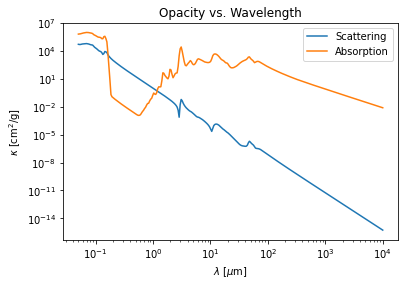

Reading dustkappa_astrosil_001.inp


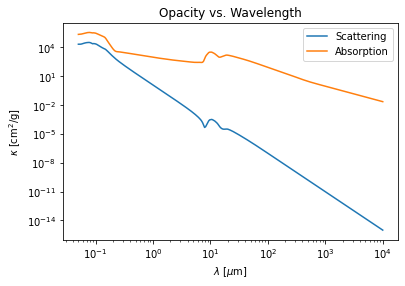

Reading dustkappa_tro_001.inp


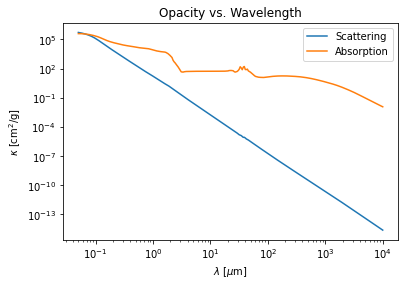

Reading dustkappa_org_001.inp


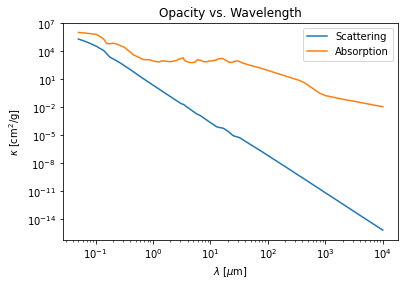

Reading dustkappa_h2o_002.inp


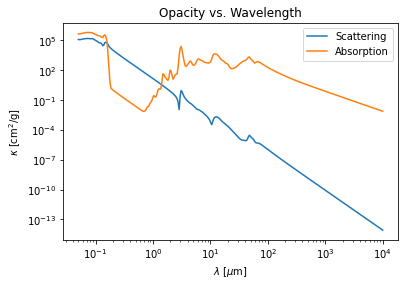

Reading dustkappa_astrosil_002.inp


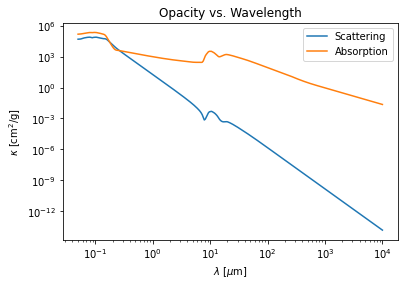

Reading dustkappa_tro_002.inp


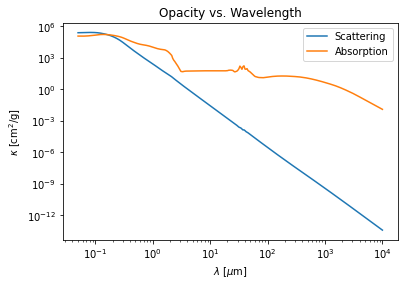

Reading dustkappa_org_002.inp


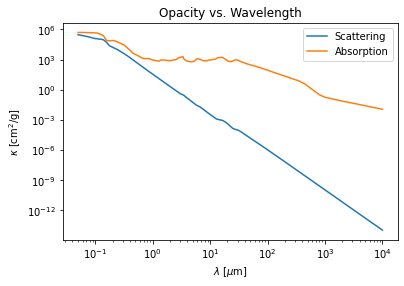

Reading dustkappa_h2o_003.inp


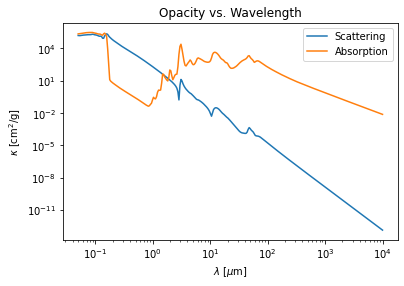

Reading dustkappa_astrosil_003.inp


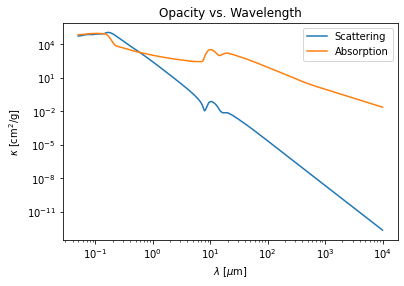

Reading dustkappa_tro_003.inp


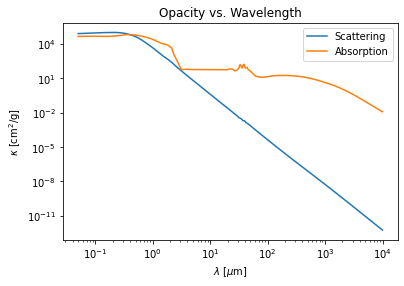

Reading dustkappa_org_003.inp


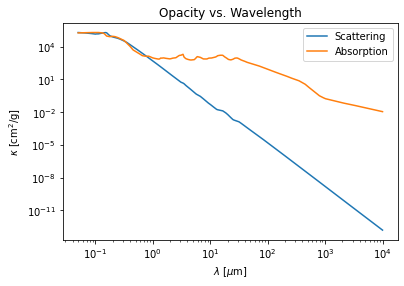

Reading dustkappa_h2o_004.inp


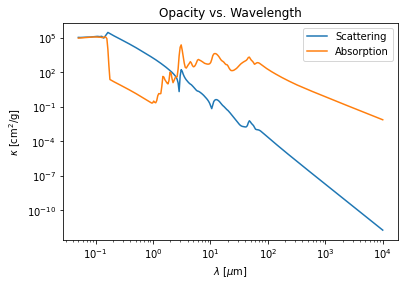

Reading dustkappa_astrosil_004.inp


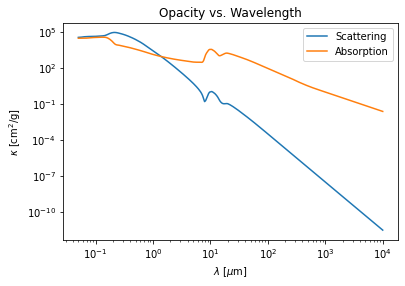

Reading dustkappa_tro_004.inp


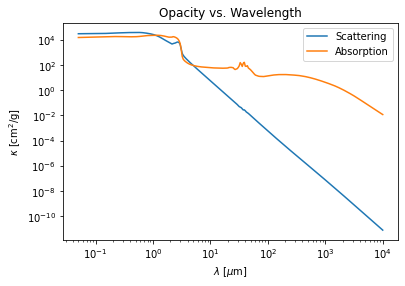

Reading dustkappa_org_004.inp


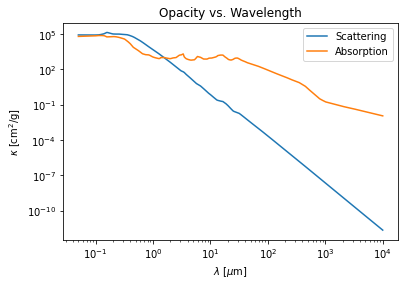

Reading dustkappa_h2o_005.inp


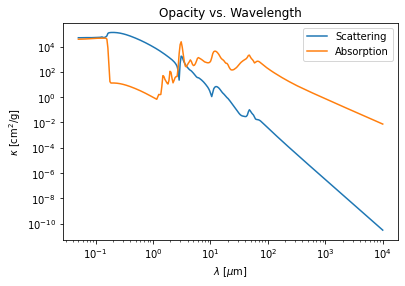

Reading dustkappa_astrosil_005.inp


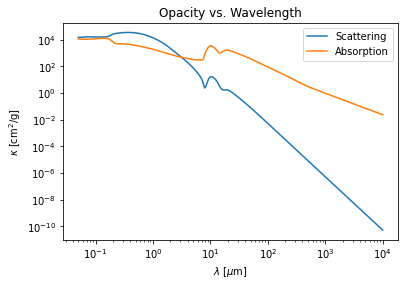

Reading dustkappa_tro_005.inp


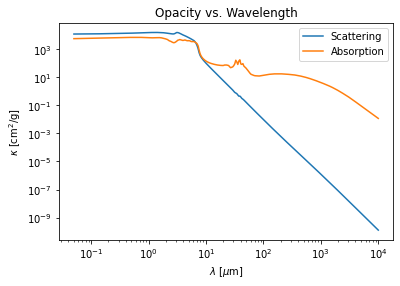

Reading dustkappa_org_005.inp


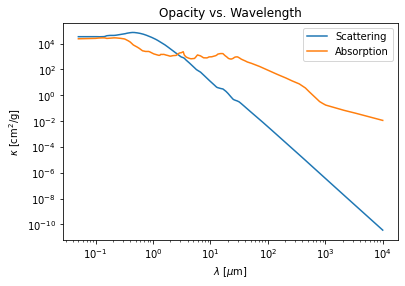

Reading dustkappa_h2o_006.inp


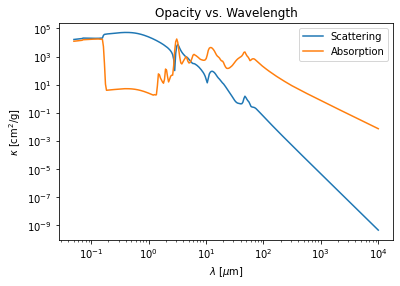

Reading dustkappa_astrosil_006.inp


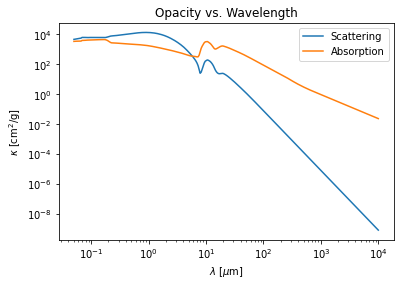

Reading dustkappa_tro_006.inp


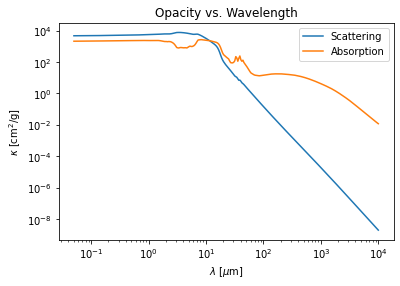

Reading dustkappa_org_006.inp


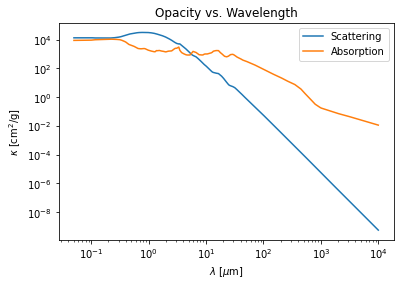

Reading dustkappa_h2o_007.inp


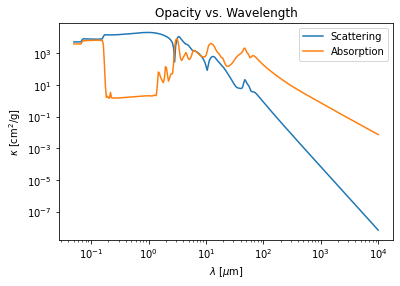

Reading dustkappa_astrosil_007.inp


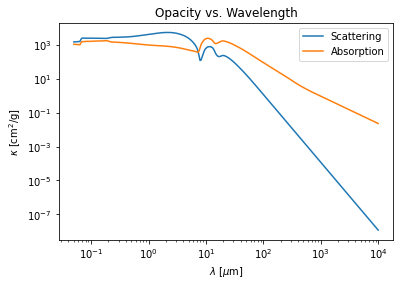

Reading dustkappa_tro_007.inp


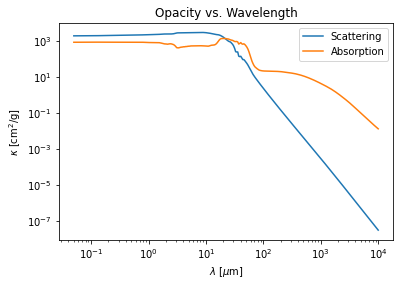

Reading dustkappa_org_007.inp


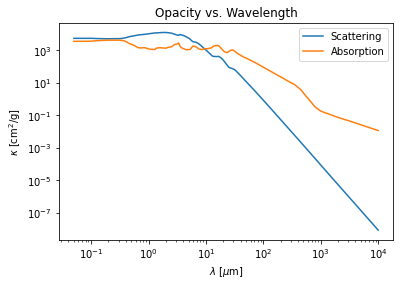

Reading dustkappa_h2o_008.inp


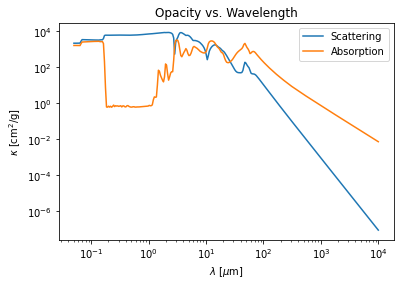

Reading dustkappa_astrosil_008.inp


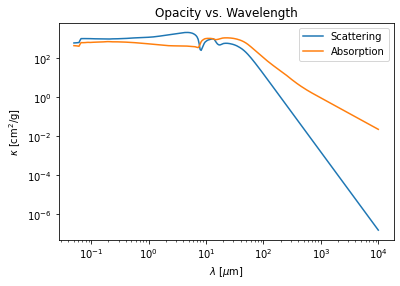

Reading dustkappa_tro_008.inp


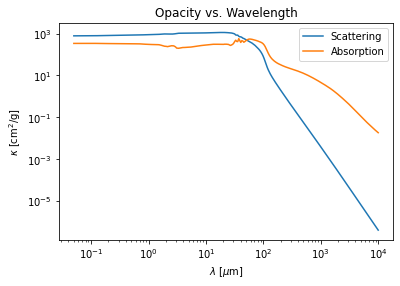

Reading dustkappa_org_008.inp


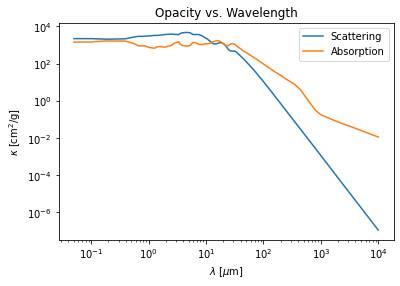

Reading dustkappa_h2o_009.inp


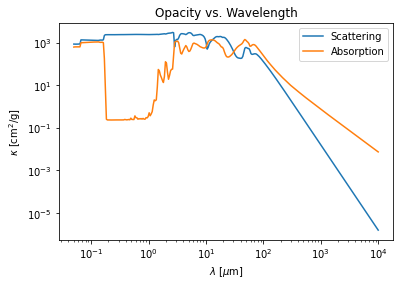

Reading dustkappa_astrosil_009.inp


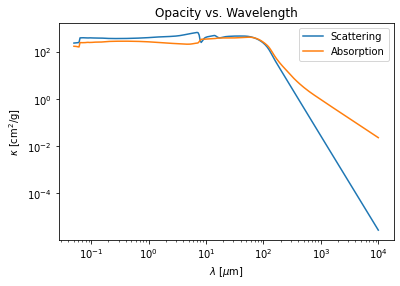

Reading dustkappa_tro_009.inp


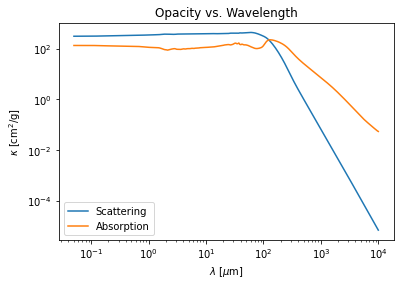

Reading dustkappa_org_009.inp


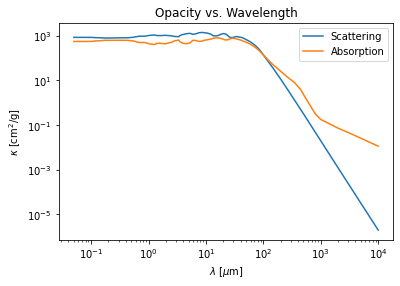

Reading dustkappa_h2o_010.inp


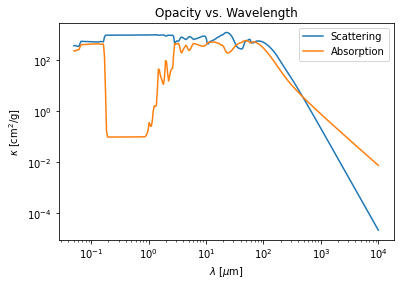

Reading dustkappa_astrosil_010.inp


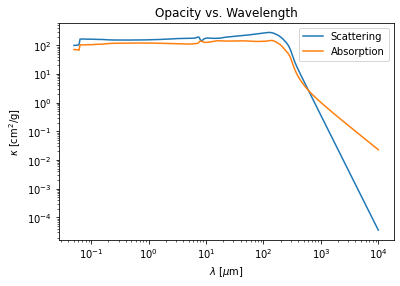

Reading dustkappa_tro_010.inp


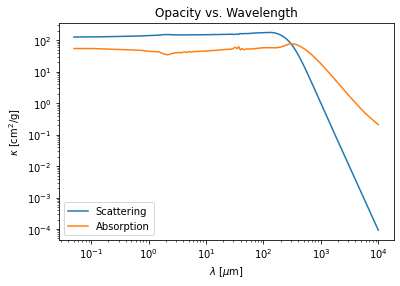

Reading dustkappa_org_010.inp


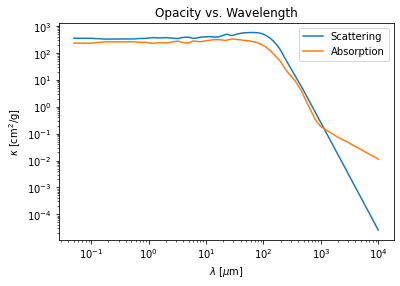

Reading dustkappa_h2o_011.inp


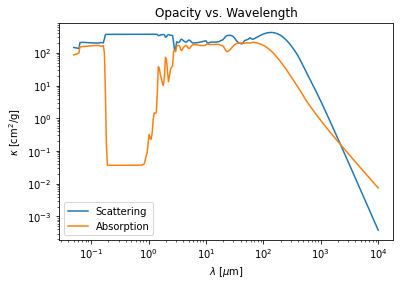

Reading dustkappa_astrosil_011.inp


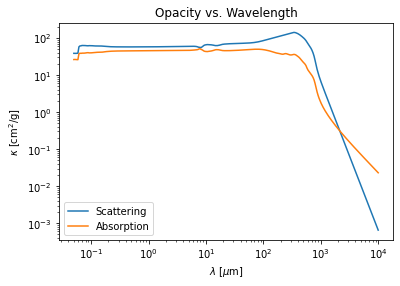

Reading dustkappa_tro_011.inp


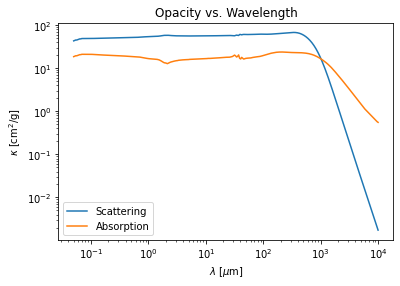

Reading dustkappa_org_011.inp


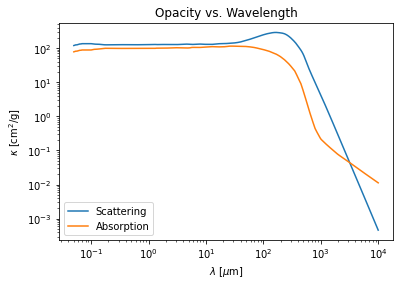

Reading dustkappa_h2o_012.inp


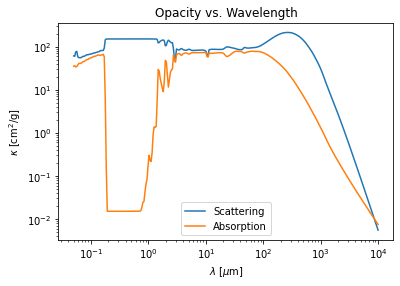

Reading dustkappa_astrosil_012.inp


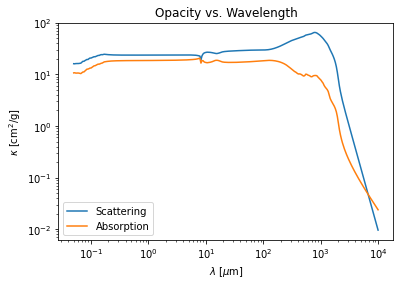

Reading dustkappa_tro_012.inp


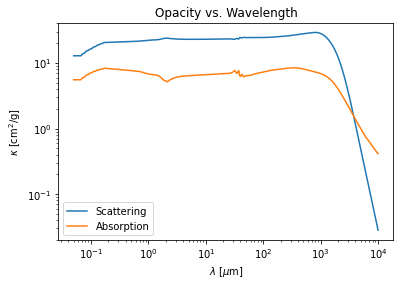

Reading dustkappa_org_012.inp


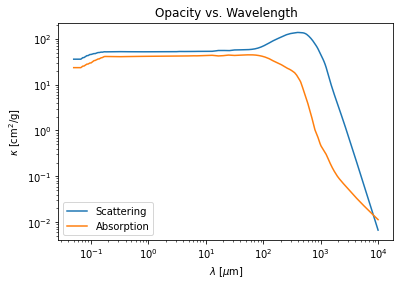

Reading dustkappa_h2o_013.inp


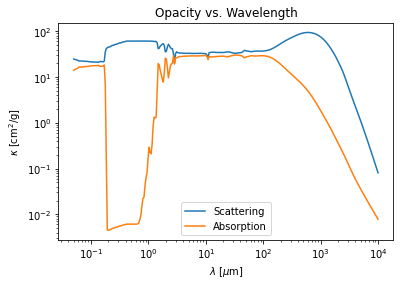

Reading dustkappa_astrosil_013.inp


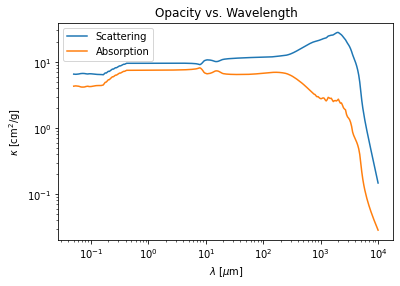

Reading dustkappa_tro_013.inp


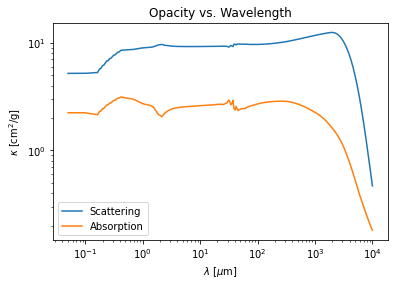

Reading dustkappa_org_013.inp


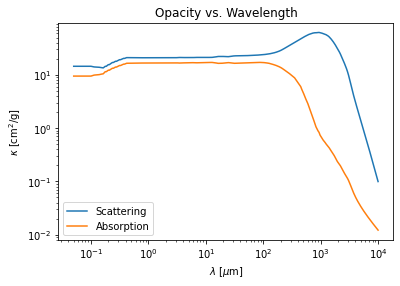

Reading dustkappa_h2o_014.inp


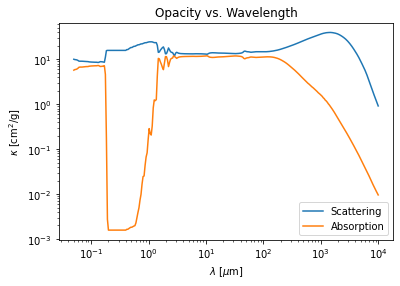

Reading dustkappa_astrosil_014.inp


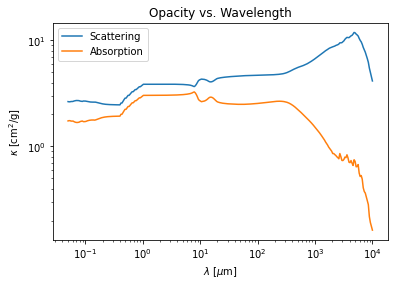

Reading dustkappa_tro_014.inp


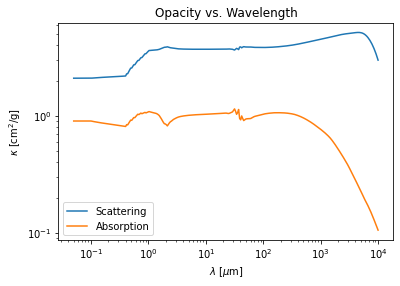

Reading dustkappa_org_014.inp


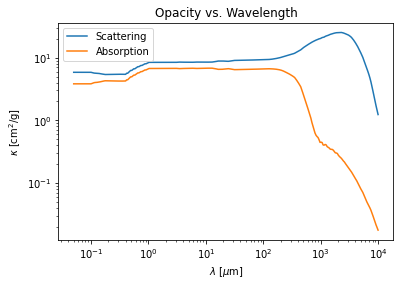

Reading dustkappa_h2o_015.inp


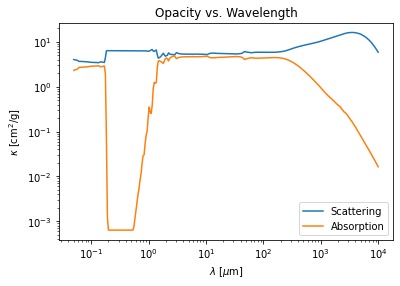

Reading dustkappa_astrosil_015.inp


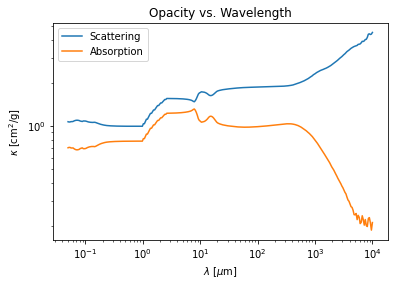

Reading dustkappa_tro_015.inp


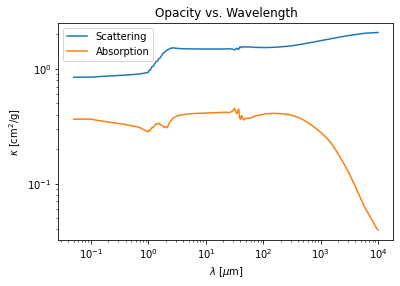

Reading dustkappa_org_015.inp


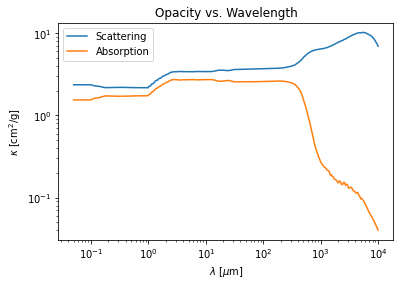

Reading dustkappa_h2o_016.inp


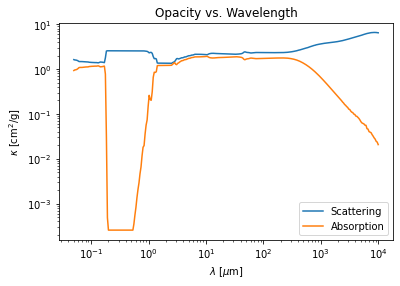

Reading dustkappa_astrosil_016.inp


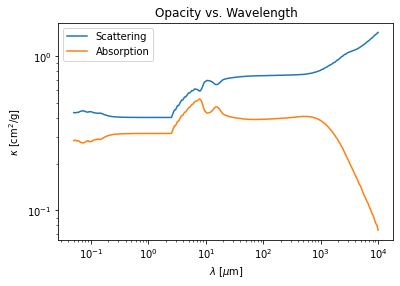

Reading dustkappa_tro_016.inp


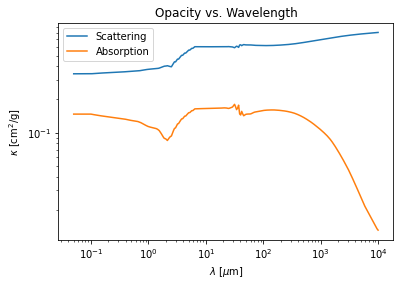

Reading dustkappa_org_016.inp


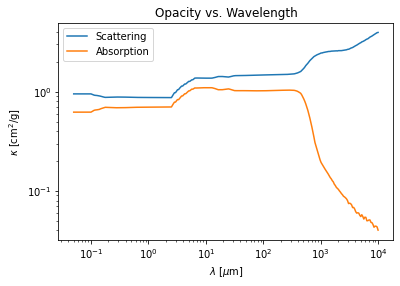

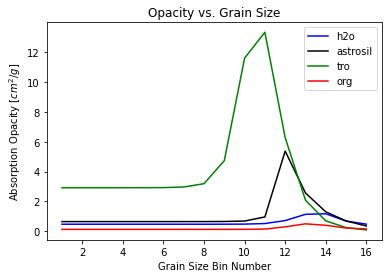

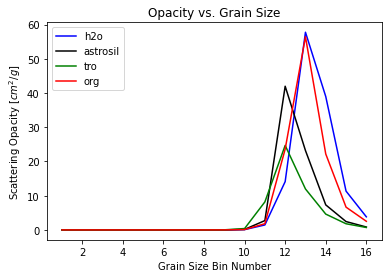

In [104]:
#Plot opacities at a given wavelength as a function of grain size for all dust materials

import radmc3dPy
pop_num = 16
wavelength = 1250
Kabs_h2o = [[] for i in range(0, pop_num)]
Kabs_astrosil = [[] for i in range(0, pop_num)]
Kabs_tro = [[] for i in range(0, pop_num)]
Kabs_org = [[] for i in range(0, pop_num)]
Ksca_h2o = [[] for i in range(0, pop_num)]
Ksca_astrosil = [[] for i in range(0, pop_num)]
Ksca_tro = [[] for i in range(0, pop_num)]
Ksca_org = [[] for i in range(0, pop_num)]
bin_list = [i for i in range(1, pop_num + 1)]
for i in range(1, 17):
    if i < 10:
        opac = analyze.readOpac(ext = ['h2o_00'+str(i)])
        wav_to_index = np.abs(opac.wav[0] - wavelength).argmin()
        Kabs_h2o[i - 1] = opac.kabs[0][wav_to_index]
        Ksca_h2o[i - 1] = opac.ksca[0][wav_to_index]
        plt.loglog(opac.wav[0], opac.ksca[0], label = 'Scattering')
        plt.loglog(opac.wav[0], opac.kabs[0], label = 'Absorption')
        plt.xlabel(r'$\lambda$ [$\mu$m]')
        plt.ylabel('$\kappa$ [cm$^2$/g]')
        plt.title('Opacity vs. Wavelength')
        plt.legend()
        plt.show()

        opac = analyze.readOpac(ext = ['astrosil_00'+str(i)])
        wav_to_index = np.abs(opac.wav[0] - wavelength).argmin()
        Kabs_astrosil[i - 1] = opac.kabs[0][wav_to_index]
        Ksca_astrosil[i - 1] = opac.ksca[0][wav_to_index]
        plt.loglog(opac.wav[0], opac.ksca[0], label = 'Scattering')
        plt.loglog(opac.wav[0], opac.kabs[0], label = 'Absorption')
        plt.xlabel(r'$\lambda$ [$\mu$m]')
        plt.ylabel('$\kappa$ [cm$^2$/g]')
        plt.title('Opacity vs. Wavelength')
        plt.legend()
        plt.show()

        opac = analyze.readOpac(ext = ['tro_00'+str(i)])
        wav_to_index = np.abs(opac.wav[0] - wavelength).argmin()
        Kabs_tro[i - 1] = opac.kabs[0][wav_to_index]
        Ksca_tro[i - 1] = opac.ksca[0][wav_to_index]
        plt.loglog(opac.wav[0], opac.ksca[0], label = 'Scattering')
        plt.loglog(opac.wav[0], opac.kabs[0], label = 'Absorption')
        plt.xlabel(r'$\lambda$ [$\mu$m]')
        plt.ylabel('$\kappa$ [cm$^2$/g]')
        plt.title('Opacity vs. Wavelength')
        plt.legend()
        plt.show()

        opac = analyze.readOpac(ext = ['org_00'+str(i)])
        wav_to_index = np.abs(opac.wav[0] - wavelength).argmin()
        Kabs_org[i - 1] = opac.kabs[0][wav_to_index]
        Ksca_org[i - 1] = opac.ksca[0][wav_to_index]
        plt.loglog(opac.wav[0], opac.ksca[0], label = 'Scattering')
        plt.loglog(opac.wav[0], opac.kabs[0], label = 'Absorption')
        plt.xlabel(r'$\lambda$ [$\mu$m]')
        plt.ylabel('$\kappa$ [cm$^2$/g]')
        plt.title('Opacity vs. Wavelength')
        plt.legend()
        plt.show()
    else:
        opac = analyze.readOpac(ext = ['h2o_0'+str(i)])
        wav_to_index = np.abs(opac.wav[0] - wavelength).argmin()
        Kabs_h2o[i - 1] = opac.kabs[0][wav_to_index]
        Ksca_h2o[i - 1] = opac.ksca[0][wav_to_index]
        plt.loglog(opac.wav[0], opac.ksca[0], label = 'Scattering')
        plt.loglog(opac.wav[0], opac.kabs[0], label = 'Absorption')
        plt.xlabel(r'$\lambda$ [$\mu$m]')
        plt.ylabel('$\kappa$ [cm$^2$/g]')
        plt.title('Opacity vs. Wavelength')
        plt.legend()
        plt.show()

        opac = analyze.readOpac(ext = ['astrosil_0'+str(i)])
        wav_to_index = np.abs(opac.wav[0] - wavelength).argmin()
        Kabs_astrosil[i - 1] = opac.kabs[0][wav_to_index]
        Ksca_astrosil[i - 1] = opac.ksca[0][wav_to_index]
        plt.loglog(opac.wav[0], opac.ksca[0], label = 'Scattering')
        plt.loglog(opac.wav[0], opac.kabs[0], label = 'Absorption')
        plt.xlabel(r'$\lambda$ [$\mu$m]')
        plt.ylabel('$\kappa$ [cm$^2$/g]')
        plt.title('Opacity vs. Wavelength')
        plt.legend()
        plt.show()

        opac = analyze.readOpac(ext = ['tro_0'+str(i)])
        wav_to_index = np.abs(opac.wav[0] - wavelength).argmin()
        Kabs_tro[i - 1] = opac.kabs[0][wav_to_index]
        Ksca_tro[i - 1] = opac.ksca[0][wav_to_index]
        plt.loglog(opac.wav[0], opac.ksca[0], label = 'Scattering')
        plt.loglog(opac.wav[0], opac.kabs[0], label = 'Absorption')
        plt.xlabel(r'$\lambda$ [$\mu$m]')
        plt.ylabel('$\kappa$ [cm$^2$/g]')
        plt.title('Opacity vs. Wavelength')
        plt.legend()
        plt.show()

        opac = analyze.readOpac(ext = ['org_0'+str(i)])
        wav_to_index = np.abs(opac.wav[0] - wavelength).argmin()
        Kabs_org[i - 1] = opac.kabs[0][wav_to_index]
        Ksca_org[i - 1] = opac.ksca[0][wav_to_index]
        plt.loglog(opac.wav[0], opac.ksca[0], label = 'Scattering')
        plt.loglog(opac.wav[0], opac.kabs[0], label = 'Absorption')
        plt.xlabel(r'$\lambda$ [$\mu$m]')
        plt.ylabel('$\kappa$ [cm$^2$/g]')
        plt.title('Opacity vs. Wavelength')
        plt.legend()
        plt.show()
        
plt.plot(bin_list, Kabs_h2o, label = 'h2o', color = 'blue')
plt.plot(bin_list, Kabs_astrosil, label = 'astrosil', color = 'black')
plt.plot(bin_list, Kabs_tro, label = 'tro', color = 'green')
plt.plot(bin_list, Kabs_org, label = 'org', color = 'red')
plt.xlabel('Grain Size Bin Number')
plt.ylabel('Absorption Opacity [$cm^2 / g$]')
plt.title('Opacity vs. Grain Size')
plt.legend()
plt.show()

plt.plot(bin_list, Ksca_h2o, label = 'h2o', color = 'blue')
plt.plot(bin_list, Ksca_astrosil, label = 'astrosil', color = 'black')
plt.plot(bin_list, Ksca_tro, label = 'tro', color = 'green')
plt.plot(bin_list, Ksca_org, label = 'org', color = 'red')
plt.xlabel('Grain Size Bin Number')
plt.ylabel('Scattering Opacity [$cm^2 / g$]')
plt.title('Opacity vs. Grain Size')
plt.legend()
plt.show()

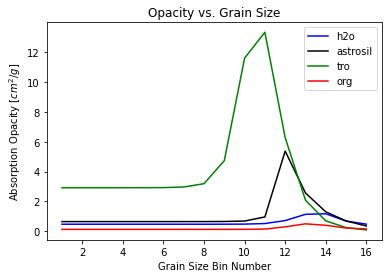

In [79]:
plt.plot(bin_list, Kabs_h2o, label = 'h2o', color = 'blue')
plt.plot(bin_list, Kabs_astrosil, label = 'astrosil', color = 'black')
plt.plot(bin_list, Kabs_tro, label = 'tro', color = 'green')
plt.plot(bin_list, Kabs_org, label = 'org', color = 'red')
plt.xlabel('Grain Size Bin Number')
plt.ylabel('Absorption Opacity [$cm^2 / g$]')
plt.title('Opacity vs. Grain Size')
plt.legend()
plt.show()

plt.plot(bin_list, Ksca_h2o, label = 'h2o', color = 'blue')
plt.plot(bin_list, Ksca_astrosil, label = 'astrosil', color = 'black')
plt.plot(bin_list, Ksca_tro, label = 'tro', color = 'green')
plt.plot(bin_list, Ksca_org, label = 'org', color = 'red')
plt.xlabel('Grain Size Bin Number')
plt.ylabel('Scattering Opacity [$cm^2 / g$]')
plt.title('Opacity vs. Grain Size')
plt.legend()
plt.show()

In [96]:
#Returns a list with the opacity for each dust material at a given wavelength
def KappaWav_func(wavelength, materials):
    KappaWav_list = [[] for i in range(0, len(materials))]
    for i in range(0, len(materials)):
        opac = analyze.readOpac(ext = [materials[i]])
        wav_to_index = np.abs(opac.wav[0] - wavelength).argmin() 
        KappaWav_list[i] = opac.kabs[0][wav_to_index]
        
    return KappaWav_list

In [97]:
from IPython.display import clear_output

def pert_param_search(amp_initial, amp_final, loc_initial, loc_final, a_step, l_step, wavelength, materials):
    #Compute the noise level
    rad_setup(r, 0, 1)
    p.run(['radmc3d', 'mctherm', 'setthreads', '8'])
    data = analyze.readData()
    NoPertTemp = np.average(np.array(data.dusttemp[:,:,:,0].T), axis = 0)
    KappaWav_list = KappaWav_func(wavelength, materials) #Get a list of opacity at desired wavelength
    rhodust = data.rhodust #Save dust density array to a variable
    VDpop_sum = sum(np.transpose(rhodust)) #Sum the density arrays of the dust materials
    VDphi_mean = sum(VDpop_sum) / len(VDpop_sum) #Average over the phi direction
    m_frac = [[] for k in range(0, len(materials))] #Initialize mass fraction list
    for k in range(0, len(materials)):
        m_frac[k] = (sum(np.transpose(rhodust)[k]) / len(np.transpose(rhodust)[k])) / VDphi_mean

    KappaCoord_list = [[] for k in range(0, len(materials))] #Initialize list for opacity as a function of r and theta
    for k in range(0, len(materials)):
        KappaCoord_list[k] = m_frac[k]*KappaWav_list[k]

    NoPertKappa = sum(KappaCoord_list) #Sum over the dust material axis to find the total opacity as a function of r and theta
    clear_output()
    
    #Define relevant lists
    sigmad_list = [[[] for j in range(0, int((amp_final - amp_initial) / a_step))] for i in range(0, int((loc_final - loc_initial) / l_step))] 
    temp_list = [[[] for j in range(0, int((amp_final - amp_initial) / a_step))] for i in range(0, int((loc_final - loc_initial) / l_step))]
    kappa_list = [[[] for j in range(0, int((amp_final - amp_initial) / a_step))] for i in range(0, int((loc_final - loc_initial) / l_step))]
    for i in range(0, int((loc_final - loc_initial) / l_step)):
        for j in range(0, int((amp_final - amp_initial) / a_step)):
            sigmad = rad_setup(r, j*a_step + amp_initial, i*l_step + loc_initial) #Write the input files
            sigmad_list[i][j] = np.array(sigmad) #Update surface density list
            p.run(['radmc3d', 'mctherm', 'setthreads', '8']) #Run radmc3d to create output files
            KappaWav_list = KappaWav_func(wavelength, materials) #Get a list of opacity at desired wavelength
            data = analyze.readData() #Pull data
            rhodust = data.rhodust #Save dust density array to a variable
            VDpop_sum = sum(np.transpose(rhodust)) #Sum the density arrays of the dust materials
            VDphi_mean = sum(VDpop_sum) / len(VDpop_sum) #Average over the phi direction
            m_frac = [[] for k in range(0, len(materials))] #Initialize mass fraction list
            for k in range(0, len(materials)):
                m_frac[k] = (sum(np.transpose(rhodust)[k]) / len(np.transpose(rhodust)[k])) / VDphi_mean

            KappaCoord_list = [[] for k in range(0, len(materials))] #Initialize list for opacity as a function of r and theta
            for k in range(0, len(materials)):
                KappaCoord_list[k] = m_frac[k]*KappaWav_list[k]

            kappa_total = sum(KappaCoord_list) #Sum over the dust material axis to find the total opacity as a function of r and theta
            kappa_list[i][j] = np.array(kappa_total) #Update opacity list
            
            temp_list[i][j] = np.average(np.array(data.dusttemp[:,:,:,0].T), axis = 0) #Update temperature list
            clear_output()
        
    
    return sigmad_list, temp_list, NoPertTemp, kappa_list, NoPertKappa;

sigmad_list, temp_list, NoPertTemp, kappa_list, NoPertKappa = pert_param_search(2, 11, 25*au, 275*au, float((11 - 2) / 9), float(((275 - 25) / 9)*au), 1000, ['h2o', 'astrosil', 'tro', 'org'])

In [64]:
#Save parameter search data to local storage

import shelve

with shelve.open('RadmcDB', 'c') as f:
    f['sigmad_list'] = sigmad_list
    f['temp_list'] = temp_list
    f['NoPertTemp'] = NoPertTemp
    f['kappa_list'] = kappa_list
    f['NoPertKappa'] = NoPertKappa
    
f.close()

In [100]:
#Pull parameter search data from local storage

import shelve

f = shelve.open('RadmcDB')

sigmad_list = f['sigmad_list']
temp_list = f['temp_list']
NoPertTemp = f['NoPertTemp']
kappa_list = f['kappa_list']
NoPertKappa = f['NoPertKappa']

Reading amr_grid.inp
Reading wavelength_micron.inp
Reading dust_density.inp
Reading dust_temperature.dat


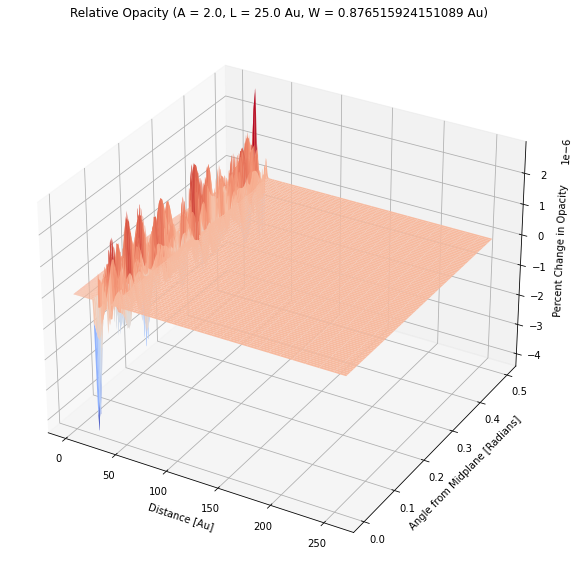

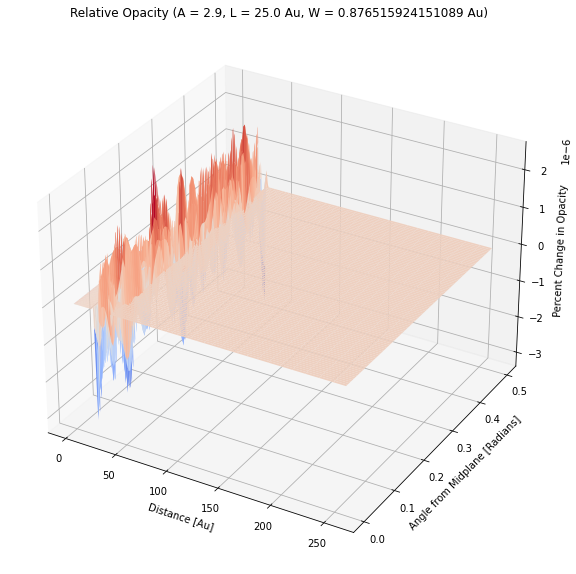

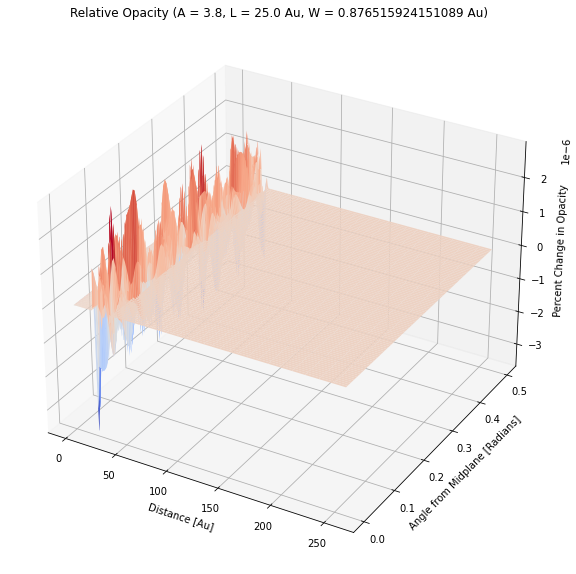

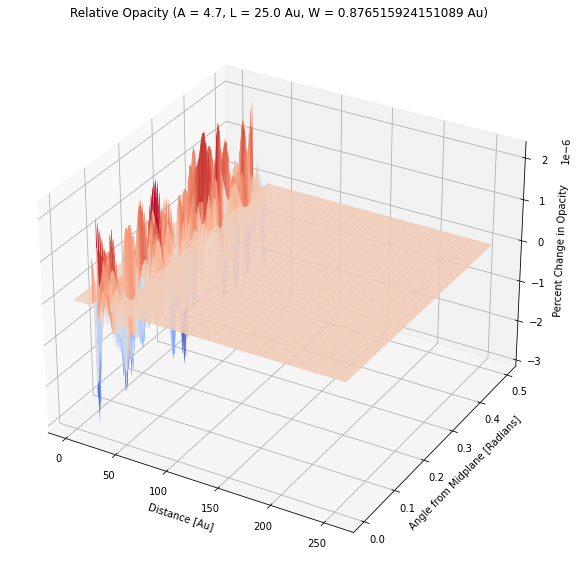

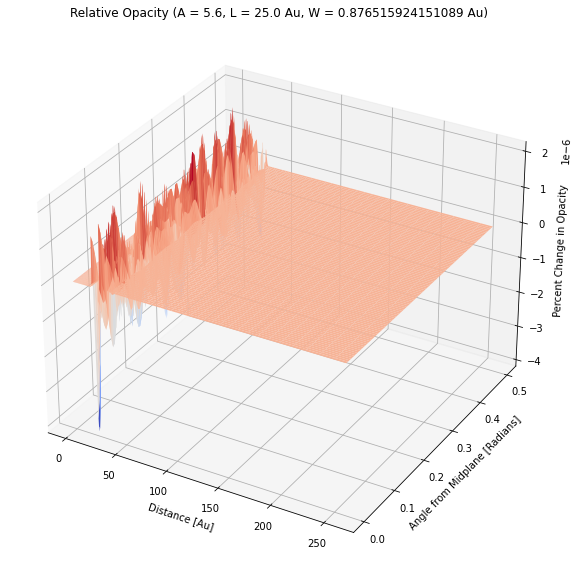

...

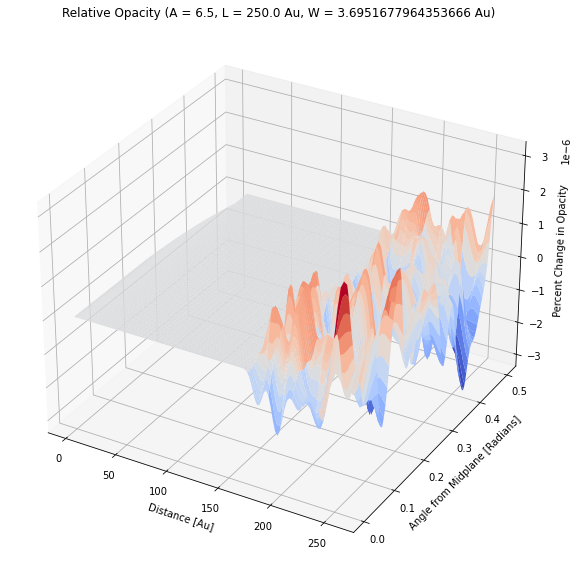

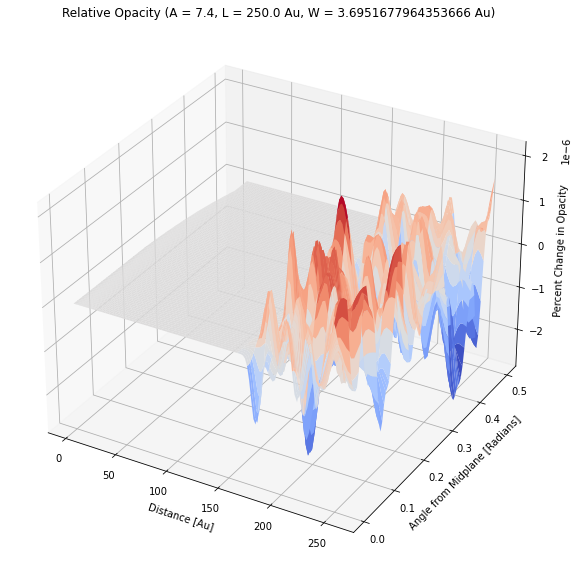

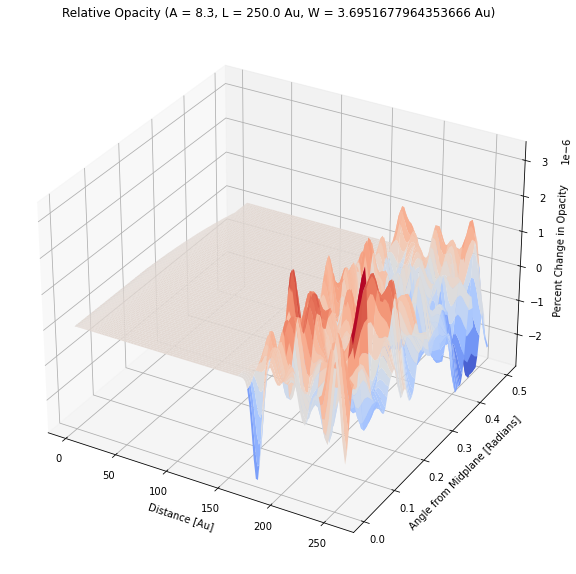

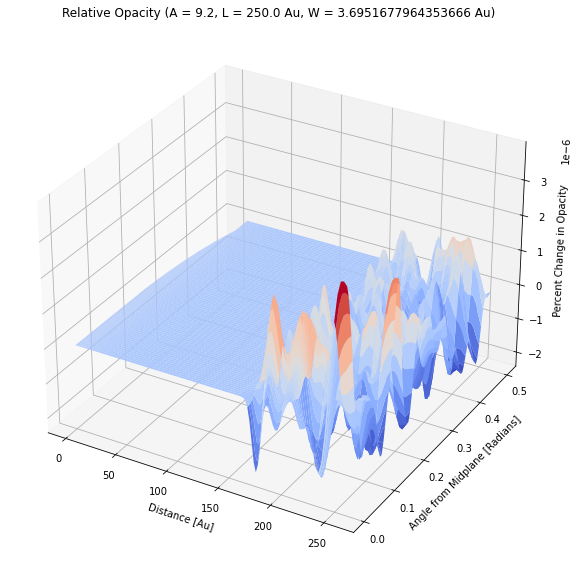

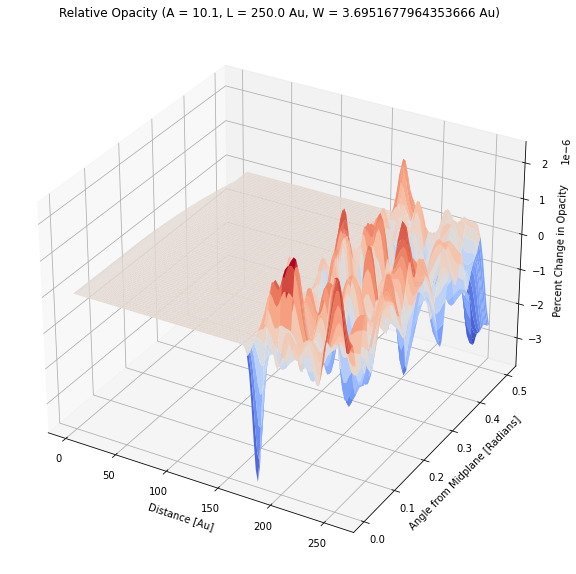

In [105]:
#Plot percent change in opacity as a function of radius and angle above the midplane

#The opacity doesn't seem to be changing as a function of r and theta because the mass fractions of the different 
#dust populations are not changing as a function of r and theta. I suspect that in order to get a change in the 
#mass fractions, we must incorporate a model that takes into account dust transport due to a higher viscosity
#drag on dust grains of a larger size.


from matplotlib.pyplot import cm
from scipy import ndimage
data = analyze.readData()
amp_initial, amp_final, loc_initial, loc_final, a_step, l_step = 2, 11, 25*au, 275*au, float((11 - 2) / 10), float(((275 - 25) / 10)*au)
loc_dim = int((loc_final - loc_initial) / l_step)
amp_dim = int((amp_final - amp_initial) / a_step)
for i in range(0, loc_dim):
    for j in range(0, amp_dim):
        #Radial grid variable and location of perturbation
        x = data.grid.x/natconst.au
        l = i*l_step + loc_initial
        a = j*a_step + amp_initial
        
        #The index of x which corresponds to the value in x closest to the location of the perturbation
        l_index = np.abs(x - (l / au)).argmin()
        width = np.sqrt(hp[l_index] / (2*au)) #Define width as one standard deviation
        
        #Plot the relative temperature data
        fig = plt.figure(figsize = (10,10))
        ax = plt.axes(projection='3d')
        ax.set_title('Relative Opacity (A = '+str(j*a_step + amp_initial)+', L = '+str((i*l_step + loc_initial)/au)+' Au, W = '+str(width)+' Au)')
        ax.set_xlabel('Distance [Au]')
        ax.set_ylabel('Angle from Midplane [Radians]')
        ax.set_zlabel('Percent Change in Opacity')
        # ax.set_zlim(-15, 15)

        X, Y = np.meshgrid(x, np.pi/2. - data.grid.y)
        #Z = sp.ndimage.filters.gaussian_filter(np.transpose(np.transpose(temp_list[i][j])[AU_to_index:]), 1.25)
        Z = sp.ndimage.filters.gaussian_filter((100*(kappa_list[i][j] - NoPertKappa) / NoPertKappa), 2)
        ax.plot_surface(X, Y, Z, rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
        plt.show()
        

Reading amr_grid.inp
Reading wavelength_micron.inp
Reading dust_density.inp
Reading dust_temperature.dat


/tmp/ipykernel_168/2746177886.py:44: RuntimeWarning: divide by zero encountered in true_divide
  Z = sp.ndimage.filters.gaussian_filter((100*(temp_list[i][j] - NoPertTemp) / NoPertTemp), 2)
/tmp/ipykernel_168/2746177886.py:44: RuntimeWarning: invalid value encountered in true_divide
  Z = sp.ndimage.filters.gaussian_filter((100*(temp_list[i][j] - NoPertTemp) / NoPertTemp), 2)


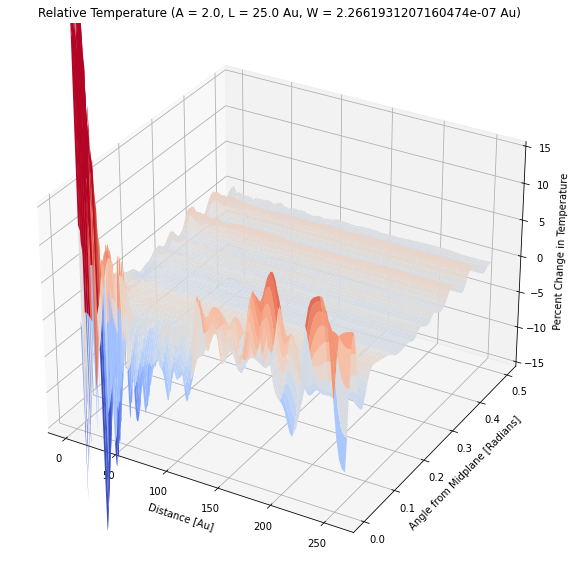

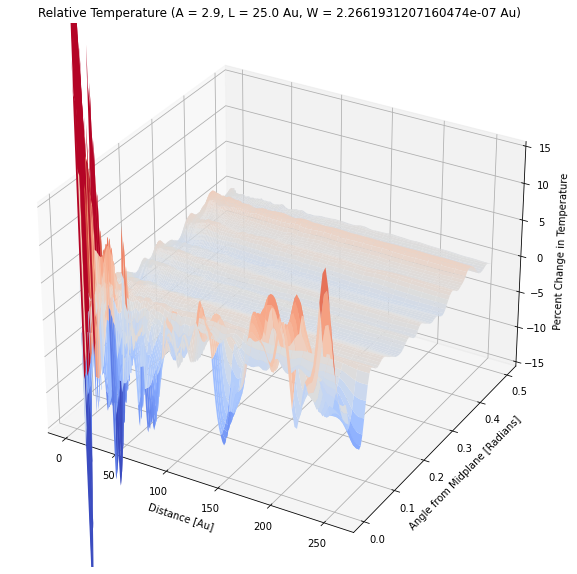

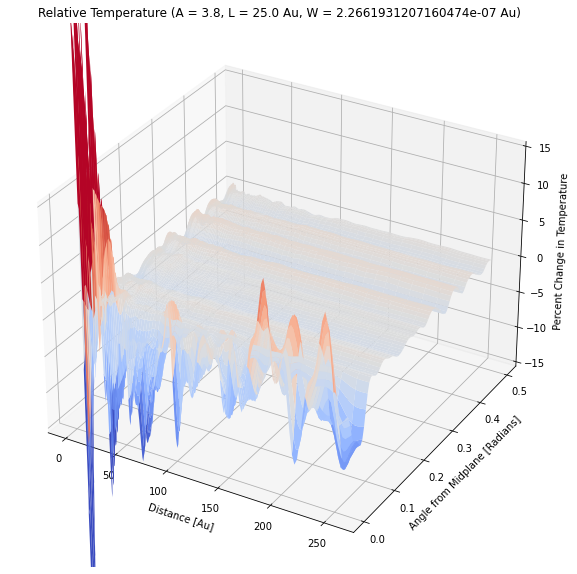

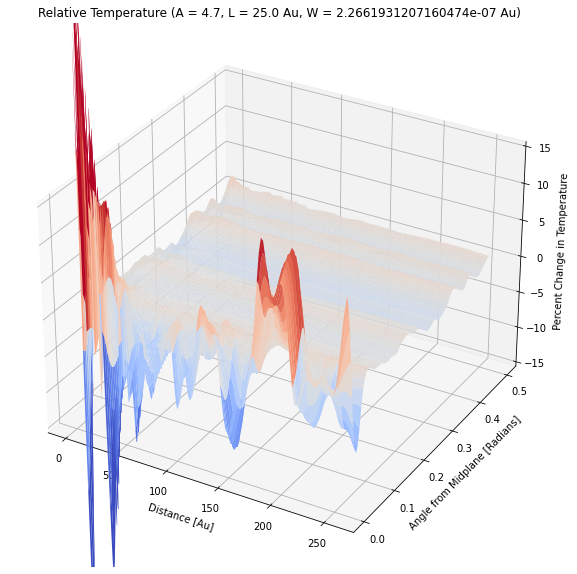

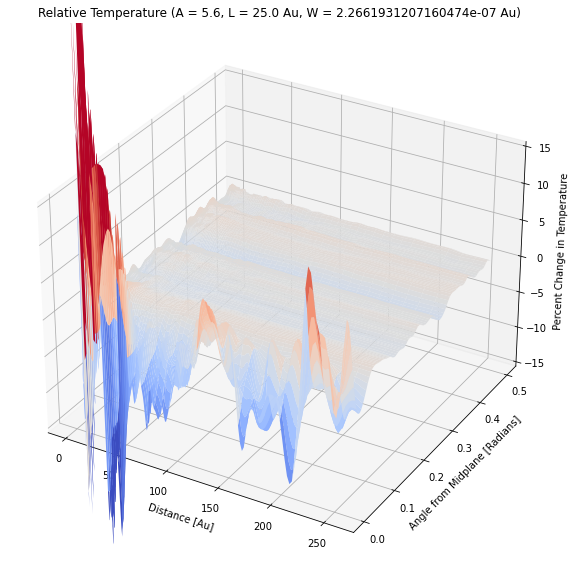

...

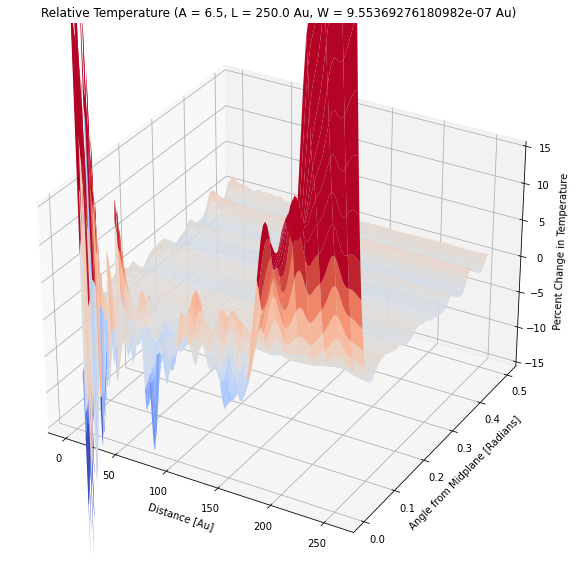

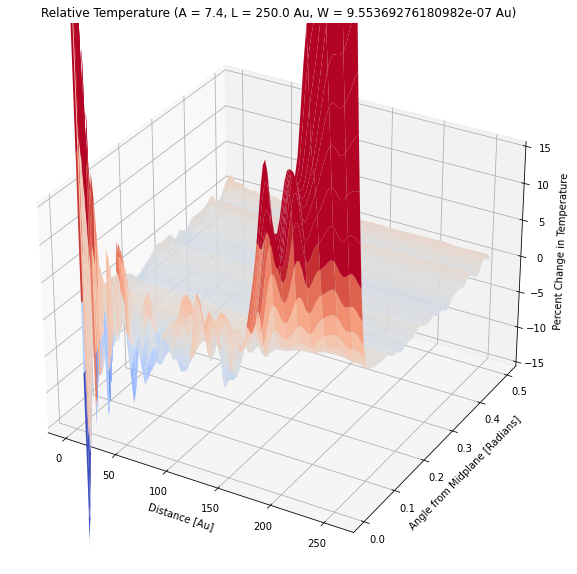

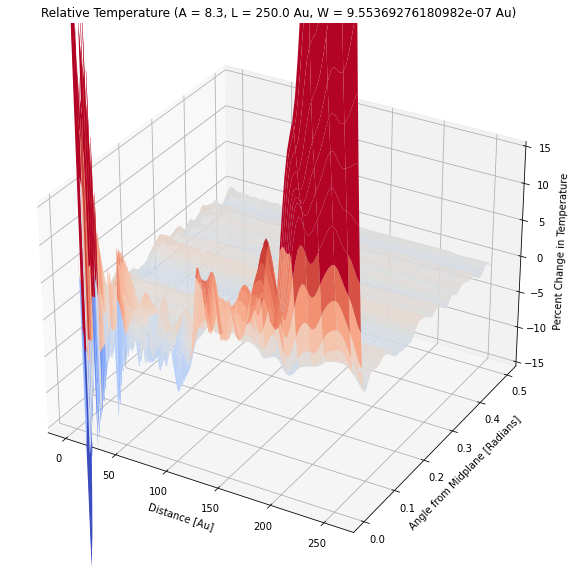

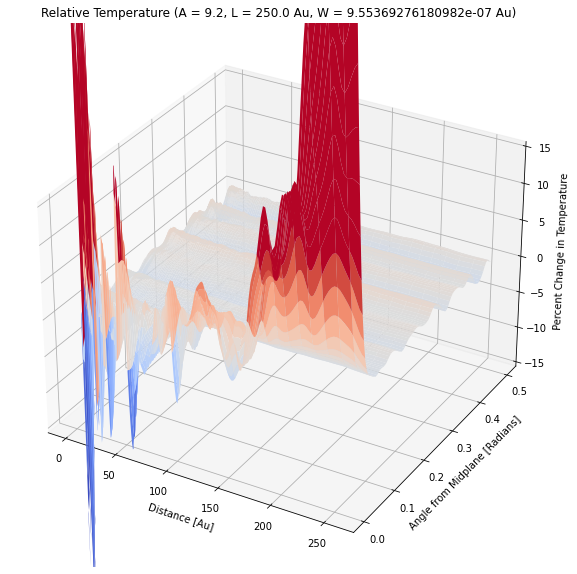

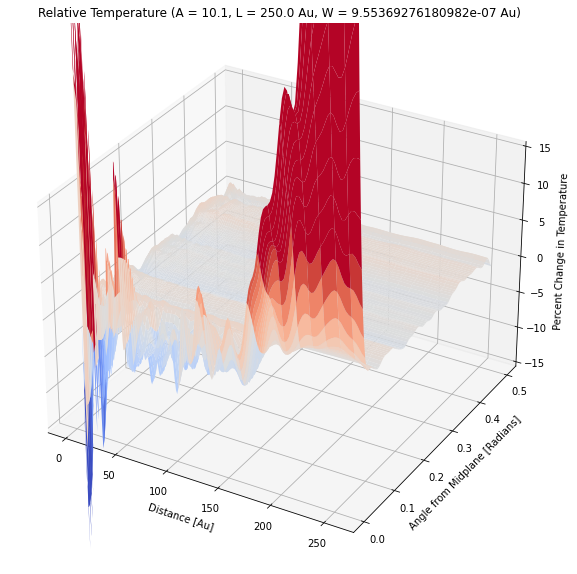

In [102]:
#Creating 3D Relative Temperature Plots
from matplotlib.pyplot import cm
from scipy import ndimage
data = analyze.readData()
amp_initial, amp_final, loc_initial, loc_final, a_step, l_step = 2, 11, 25*au, 275*au, float((11 - 2) / 10), float(((275 - 25) / 10)*au)
loc_dim = int((loc_final - loc_initial) / l_step)
amp_dim = int((amp_final - amp_initial) / a_step)
SD_amp = np.array([])
SD_loc = np.array([])
SD_width = np.array([])
for i in range(0, loc_dim):
    for j in range(0, amp_dim):
        #Radial grid variable and location of perturbation
        x = data.grid.x/natconst.au
        l = i*l_step + loc_initial
        a = j*a_step + amp_initial
        
        #The index of X which corresponds to the value in X closest to the location of the perturbation
        l_index = np.abs(x - (l / au)).argmin()
        width = np.sqrt((hp[l_index] / 2))
        
        #Append only unique amplitude and location values 
        if a not in SD_amp:
            SD_amp = np.append(SD_amp, a)
        else:
            pass
        if (l / au) not in SD_loc:
            SD_loc = np.append(SD_loc, l / au)
            SD_width = np.append(SD_width, width / au)
        else: 
            pass
        
        #Plot the relative temperature data
        fig = plt.figure(figsize = (10,10))
        ax = plt.axes(projection='3d')
        ax.set_title('Relative Temperature (A = '+str(j*a_step + amp_initial)+', L = '+str((i*l_step + loc_initial)/au)+' Au, W = '+str(width / au)+' Au)')
        ax.set_xlabel('Distance [Au]')
        ax.set_ylabel('Angle from Midplane [Radians]')
        ax.set_zlabel('Percent Change in Temperature')
        ax.set_zlim(-15, 15)

        X, Y = np.meshgrid(x, np.pi/2. - data.grid.y)
        #Z = sp.ndimage.filters.gaussian_filter(np.transpose(np.transpose(temp_list[i][j])[AU_to_index:]), 1.25)
        Z = sp.ndimage.filters.gaussian_filter((100*(temp_list[i][j] - NoPertTemp) / NoPertTemp), 2)
        ax.plot_surface(X, Y, Z, vmin = -15, vmax = 15, rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
        plt.show()
                

In [ ]:
#Creating Surface Density and Temperature Contour Plots
from matplotlib.pyplot import cm
from scipy import ndimage
amp_initial, amp_final, loc_initial, loc_final, a_step, l_step = 2, 11, 25*au, 275*au, float((11 - 2) / 2), float(((275 - 25) / 2)*au)
for i in range(0, loc_dim):
    for j in range(0, amp_dim):
        x = data.grid.x/natconst.au
        l = i*l_step + loc_initial
        a = j*a_step + amp_initial
        #The index of X which corresponds to the value in X closest to 10 AU
        AU_to_index = np.abs(x - 10).argmin()
        #The index of X which corresponds to the value in X closest to the location of the perturbation
        l_index = np.abs(x - (l / au)).argmin()
        width = hp[l_index]
        
        plt.plot(x, sigmad_list[i][j])
        plt.title('Surface Density (A = '+str(a)+', L = '+str((l / au))+' Au, W = '+str(width / au)+' Au)')
        plt.xlabel('Distance [AU]')
        plt.ylabel('Dust Surface Density [$g/cm^2$]')
        plt.show()

        fig, ax = plt.subplots()
        c = ax.contourf(x[AU_to_index:], np.pi/2.-data.grid.y, np.transpose(np.transpose(temp_list[i][j])[AU_to_index:]), 100, cmap = cm.coolwarm)
        ax.set_xlabel('r [AU]')
        ax.set_ylabel(r'$\pi/2-\theta$')
        ax.set_title('Temperature Contour (A = '+str(a)+', L = '+str((l / au))+' Au, W = '+str(width / au)+' Au)')
        ax.set_xscale('log')
        ax.set_xlim(10, 260)
        Ticks = np.linspace(15, 185, 18)
        cb = plt.colorbar(c, ticks = Ticks)
        cb.set_label('T [K]', rotation=270.)

        c = ax.contour(x[AU_to_index:], np.pi/2.-data.grid.y, np.transpose(np.transpose(temp_list[i][j])[AU_to_index:]), 15,  colors='k', linestyles='solid')
        ax.clabel(c, inline=1, fontsize=10)
        plt.show()
            


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


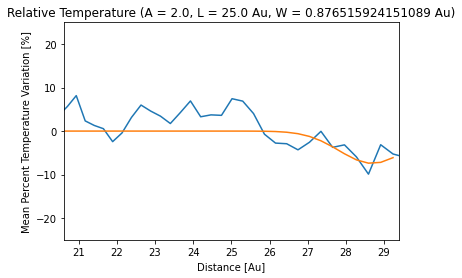

Fit Equation: 8.98exp(-(R - 18.5)**2 / 2*0.438**2) + -7.43exp(-(R - 28.7)**2 / 2*0.867**2)
Maximum Value: 8.878991130737344
262
Minimum Value: -7.37856446900641
302


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


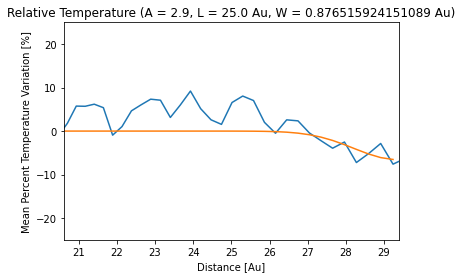

Fit Equation: 8.23exp(-(R - 18.5)**2 / 2*0.438**2) + -6.56exp(-(R - 29.3)**2 / 2*1.13**2)
Maximum Value: 8.224161805833255
263
Minimum Value: -6.525891882337057
304


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


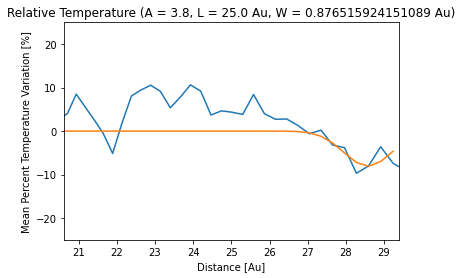

Fit Equation: 8.78exp(-(R - 18.6)**2 / 2*0.438**2) + -8.08exp(-(R - 28.6)**2 / 2*0.627**2)
Maximum Value: 8.749068360956661
262
Minimum Value: -8.081889593274271
301


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


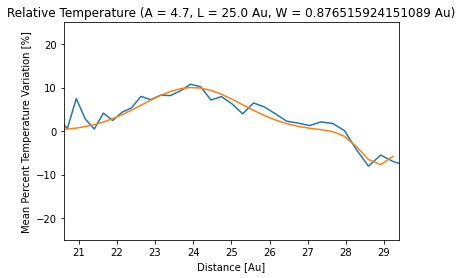

Fit Equation: 10.0exp(-(R - 24.0)**2 / 2*1.31**2) + -7.75exp(-(R - 28.9)**2 / 2*0.481**2)
Maximum Value: 10.014988412957676
286
Minimum Value: -7.710245359056501
302


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


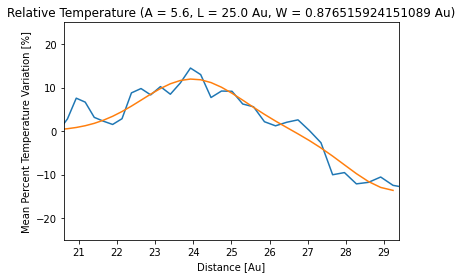

Fit Equation: 12.0exp(-(R - 24.0)**2 / 2*1.31**2) + -13.7exp(-(R - 29.3)**2 / 2*1.31**2)
Maximum Value: 11.959922555098876
286
Minimum Value: -13.636318384941386
304


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


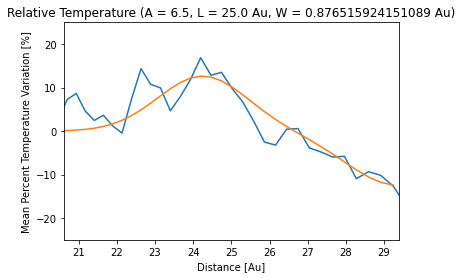

Fit Equation: 12.6exp(-(R - 24.2)**2 / 2*1.17**2) + -12.4exp(-(R - 29.3)**2 / 2*1.31**2)
Maximum Value: 12.628252842546857
287
Minimum Value: -12.399894212122193
304


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


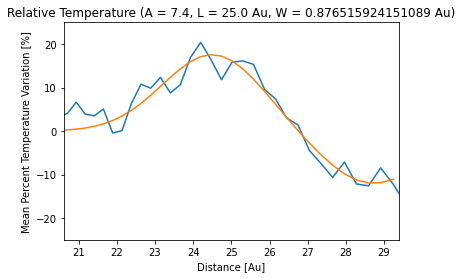

Fit Equation: 17.6exp(-(R - 24.5)**2 / 2*1.31**2) + -12.1exp(-(R - 28.7)**2 / 2*1.31**2)
Maximum Value: 17.56963508225742
287
Minimum Value: -11.93641554743262
302


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


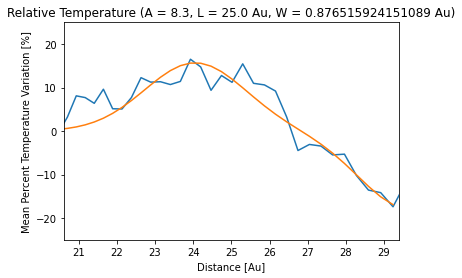

Fit Equation: 15.7exp(-(R - 24.1)**2 / 2*1.31**2) + -17.9exp(-(R - 29.7)**2 / 2*1.3**2)
Maximum Value: 15.63416490000843
286
Minimum Value: -16.915532660610264
304


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


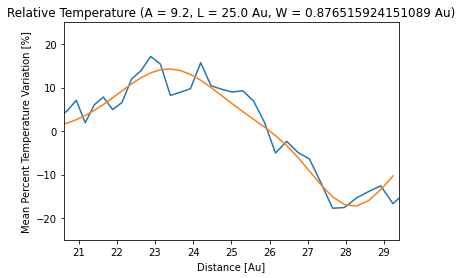

Fit Equation: 14.3exp(-(R - 23.4)**2 / 2*1.31**2) + -17.3exp(-(R - 28.2)**2 / 2*1.03**2)
Maximum Value: 14.288349433565024
282
Minimum Value: -17.234251792786576
299


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


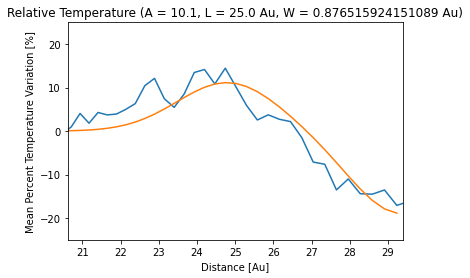

Fit Equation: 11.2exp(-(R - 24.8)**2 / 2*1.31**2) + -19.0exp(-(R - 29.3)**2 / 2*1.31**2)
Maximum Value: 11.142448087303435
289
Minimum Value: -18.86455127424268
304


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


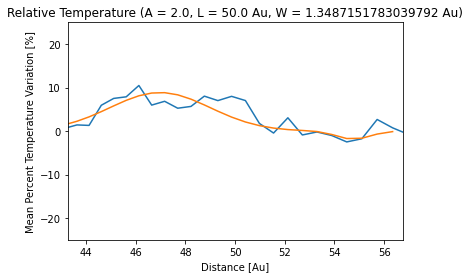

Fit Equation: 8.87exp(-(R - 47.0)**2 / 2*2.02**2) + -1.87exp(-(R - 54.8)**2 / 2*0.674**2)
Maximum Value: 8.83297610920887
345
Minimum Value: -1.7143530294055322
360


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


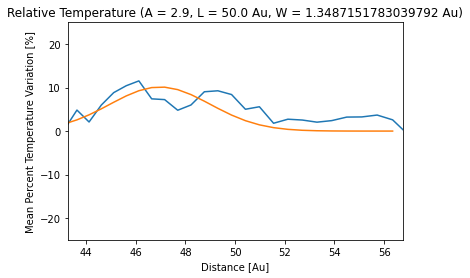

Fit Equation: 10.1exp(-(R - 47.0)**2 / 2*2.02**2) + -1.62exp(-(R - 37.0)**2 / 2*0.674**2)
Maximum Value: 10.100933513777761
345
Minimum Value: -1.6106958067906954
325


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


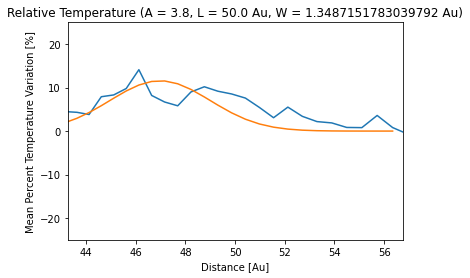

Fit Equation: 11.6exp(-(R - 47.0)**2 / 2*2.02**2) + -4.45exp(-(R - 35.9)**2 / 2*0.674**2)
Maximum Value: 11.524492044277178
345
Minimum Value: -4.28377104836347
322


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


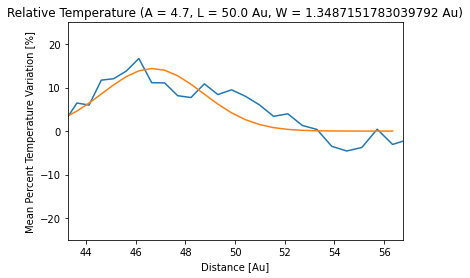

Fit Equation: 14.4exp(-(R - 46.7)**2 / 2*2.02**2) + -4.66exp(-(R - 36.2)**2 / 2*0.674**2)
Maximum Value: 14.389019021347574
345
Minimum Value: -4.582109760898994
323


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


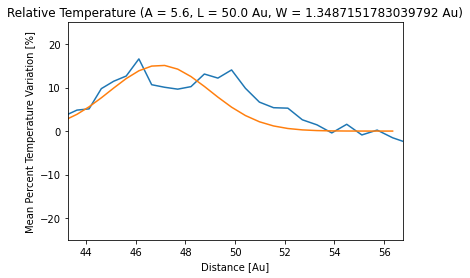

Fit Equation: 15.2exp(-(R - 47.0)**2 / 2*2.02**2) + -2.7exp(-(R - 37.8)**2 / 2*0.674**2)
Maximum Value: 15.091810383511364
345
Minimum Value: -2.680680486861201
327


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


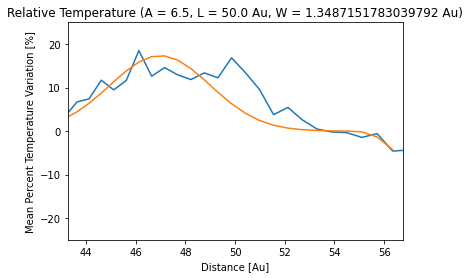

Fit Equation: 17.4exp(-(R - 47.0)**2 / 2*2.02**2) + -5.74exp(-(R - 56.9)**2 / 2*0.674**2)
Maximum Value: 17.281457774771663
345
Minimum Value: -4.2535723933373735
363


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


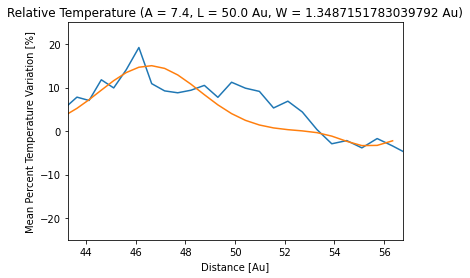

Fit Equation: 15.0exp(-(R - 46.6)**2 / 2*2.02**2) + -3.47exp(-(R - 55.4)**2 / 2*1.02**2)
Maximum Value: 15.034988401828798
345
Minimum Value: -3.3387601466919166
361


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


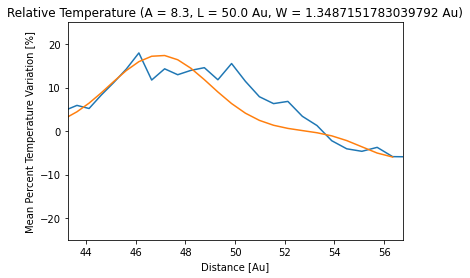

Fit Equation: 17.4exp(-(R - 47.0)**2 / 2*2.02**2) + -6.08exp(-(R - 56.6)**2 / 2*1.5**2)
Maximum Value: 17.375804239645845
345
Minimum Value: -5.966496419177848
363


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


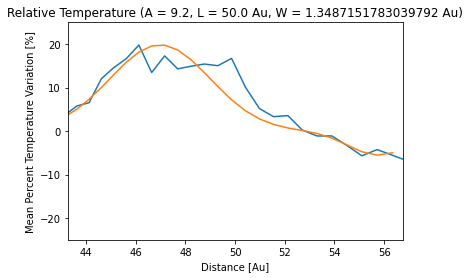

Fit Equation: 19.8exp(-(R - 47.0)**2 / 2*2.02**2) + -5.55exp(-(R - 55.8)**2 / 2*1.21**2)
Maximum Value: 19.759269241441718
345
Minimum Value: -5.541956623217174
361


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


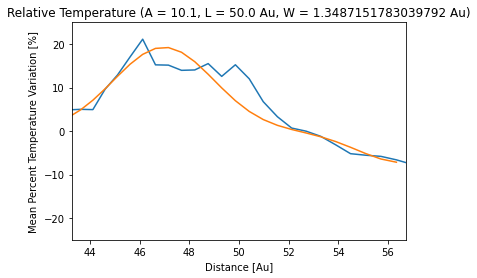

Fit Equation: 19.3exp(-(R - 47.0)**2 / 2*2.02**2) + -7.25exp(-(R - 56.6)**2 / 2*1.87**2)
Maximum Value: 19.201374270329303
345
Minimum Value: -7.158734697947203
363


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


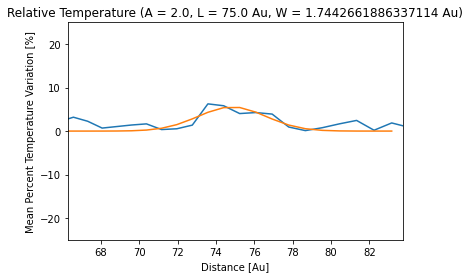

Fit Equation: 5.56exp(-(R - 74.8)**2 / 2*1.77**2) + -2.06exp(-(R - 54.1)**2 / 2*0.921**2)
Maximum Value: 5.421046719151175
387
Minimum Value: -1.996999617009385
359


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


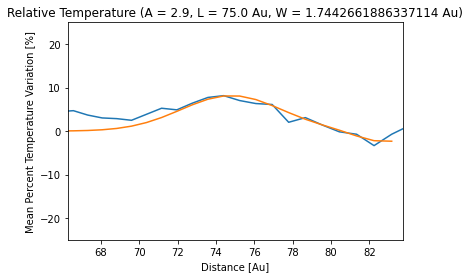

Fit Equation: 8.17exp(-(R - 74.8)**2 / 2*2.62**2) + -2.51exp(-(R - 82.7)**2 / 2*1.36**2)
Maximum Value: 8.076536925478704
388
Minimum Value: -2.33255285484052
397


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


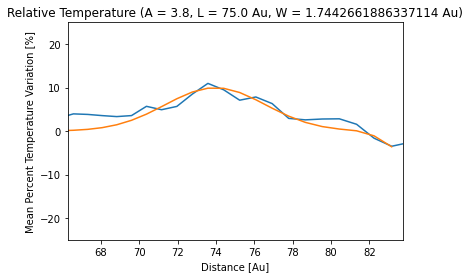

Fit Equation: 9.98exp(-(R - 74.0)**2 / 2*2.62**2) + -4.25exp(-(R - 83.7)**2 / 2*0.877**2)
Maximum Value: 9.866587283944853
387
Minimum Value: -3.6061218245493314
398


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


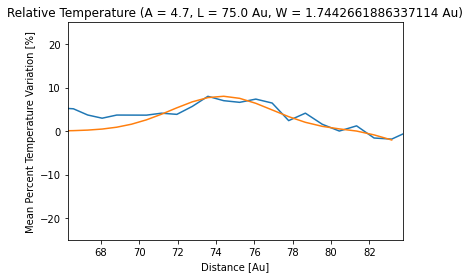

Fit Equation: 8.01exp(-(R - 74.3)**2 / 2*2.62**2) + -2.31exp(-(R - 83.7)**2 / 2*1.06**2)
Maximum Value: 8.004966217399357
387
Minimum Value: -2.046157940387514
398


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


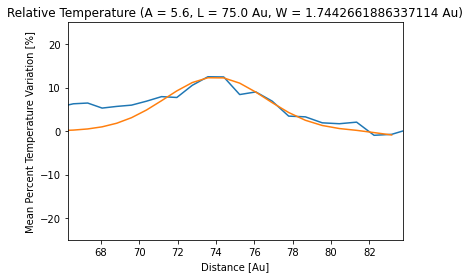

Fit Equation: 12.4exp(-(R - 74.0)**2 / 2*2.62**2) + -0.938exp(-(R - 83.3)**2 / 2*0.872**2)
Maximum Value: 12.263349255218632
387
Minimum Value: -0.8953408289779566
397


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


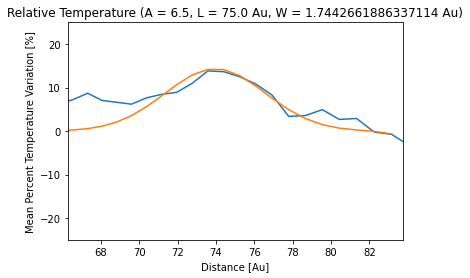

Fit Equation: 14.3exp(-(R - 74.0)**2 / 2*2.62**2) + -0.95exp(-(R - 83.9)**2 / 2*0.872**2)
Maximum Value: 14.186462151207216
387
Minimum Value: -0.6506353070647244
398


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


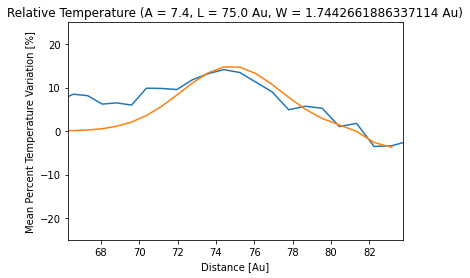

Fit Equation: 14.9exp(-(R - 74.8)**2 / 2*2.62**2) + -3.95exp(-(R - 82.9)**2 / 2*0.872**2)
Maximum Value: 14.738734856882475
388
Minimum Value: -3.7282413925098816
397


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


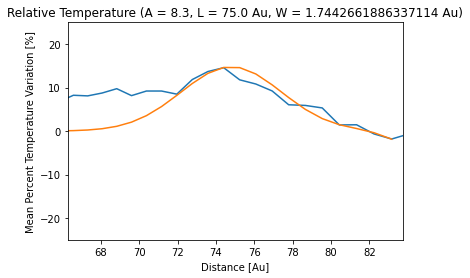

Fit Equation: 14.8exp(-(R - 74.8)**2 / 2*2.62**2) + -2.28exp(-(R - 83.7)**2 / 2*0.886**2)
Maximum Value: 14.627852497715443
388
Minimum Value: -1.8603388651978956
398


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


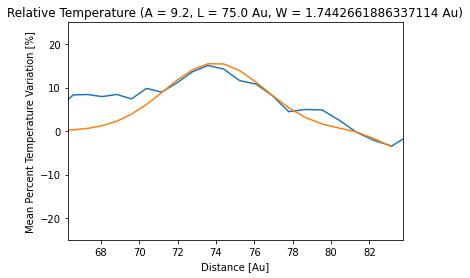

Fit Equation: 15.6exp(-(R - 74.0)**2 / 2*2.62**2) + -4.02exp(-(R - 83.7)**2 / 2*1.13**2)
Maximum Value: 15.475562723977054
387
Minimum Value: -3.623005841740299
398


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


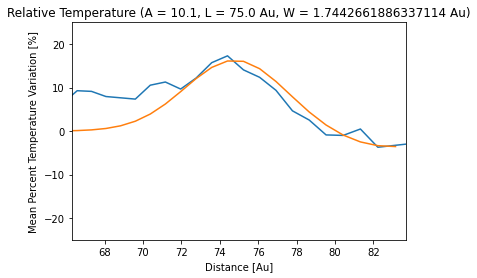

Fit Equation: 16.3exp(-(R - 74.8)**2 / 2*2.62**2) + -3.71exp(-(R - 82.7)**2 / 2*2.62**2)
Maximum Value: 16.11758595624255
388
Minimum Value: -3.558160292813076
397


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


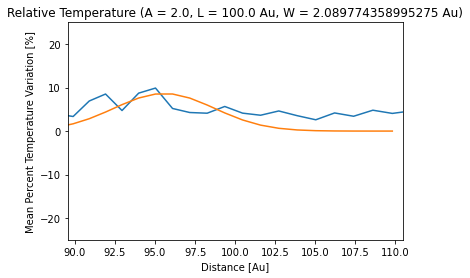

Fit Equation: 8.65exp(-(R - 95.6)**2 / 2*3.13**2) + -2.93exp(-(R - 82.6)**2 / 2*1.04**2)
Maximum Value: 8.527193859952503
410
Minimum Value: -2.725801046657321
397


/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_168/2804319828.py:46: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


ValueError: Each lower bound must be strictly less than each upper bound.

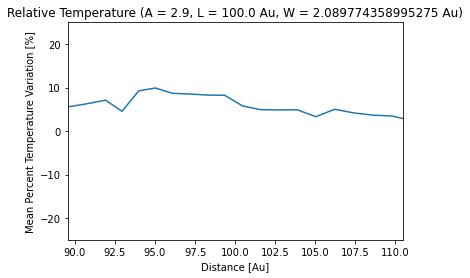

In [106]:
#Mean Relative Temperature Plots and Curve-Fitting
from scipy.optimize import curve_fit
amp_initial, amp_final, loc_initial, loc_final, a_step, l_step = 2, 11, 25*au, 275*au, float((11 - 2) / 10), float(((275 - 25) / 10)*au)
T_max = np.empty((loc_dim, amp_dim))
T_min = np.empty((loc_dim, amp_dim)) 
T_amp1 = np.empty((loc_dim, amp_dim))
T_loc1 = np.empty((loc_dim, amp_dim))
T_width1 = np.empty((loc_dim, amp_dim))
T_amp2 = np.empty((loc_dim, amp_dim))
T_loc2 = np.empty((loc_dim, amp_dim)) 
T_width2 = np.empty((loc_dim, amp_dim))
for i in range(0, int((loc_final - loc_initial) / l_step)):
    for j in range(0, int((amp_final - amp_initial) / a_step)):
        x = data.grid.x/natconst.au
        l = i*l_step + loc_initial
        a = j*a_step + amp_initial
        
        #The index of x which corresponds to the value in x closest to the location of the perturbation
        l_index = np.abs(x - (l / au)).argmin()
        width = np.sqrt(hp[l_index] / (2*au))
        
        #Create a loop to find an equally spaced interval on either side of the perturbation
        for backward in range(1, l_index): 
            if abs(x[l_index] / au - x[l_index - backward] / au) <= 5*width: 
                pass
            else:
                B = backward
                break

        for forward in range(1, len(x) - l_index):
            if abs(x[l_index] - x[l_index + forward]) <= 5*width:
                pass
            else:
                F = forward
                break
        
        fig, ax = plt.subplots()
        ax.set_title('Relative Temperature (A = '+str(a)+', L = '+str(l / au)+' Au, W = '+str(width)+' Au)')
        ax.set_xlabel('Distance [Au]')
        ax.set_ylabel('Mean Percent Temperature Variation [%]')
        ax.set_ylim(-25, 25)
        
        #Calculate the mean percent change in temperature over the first 20 values in the angular direction
        T_for_mean = [[] for k in range(0, 19)]
        for k in range(-20,-1):
            T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
        
        T_mean = sum(T_for_mean) / len(T_for_mean)
        ax.set_xlim((l / au - 5*width), (l / au + 5*width))
        ax.plot(x, T_mean)
        
        #Find the maximum value of the data in the desired range
        max_value = 0
        index = l_index - B
        max_index = l_index - B
        for n in T_mean[(l_index - B):(l_index + F)]:
            index = index + 1
            if n > max_value:
                max_value = n
                max_index = index
            else:
                pass
        
        
        #Find the minimum value of the data in the desired range
        min_value = 0
        index = l_index - B
        min_index = l_index - B
        for n in T_mean[(l_index - B):(l_index + F)]:
            index = index + 1
            if n < min_value:
                min_value = n
                min_index = index
            else:
                pass
        
        #Define a function form for curve-fitting
        def fit_form(dist, a, b, c, d, e, f):
            return a*np.exp(-(dist - b)**2 / (2*c**2)) + d*np.exp(-(dist - e)**2 / (2*f**2))
            #return a*dist**5 + b*dist**4 + c*dist**3 + d*dist**2 + e*dist + f
        
        #Focus on the data in the desired range
        xdata = x[(l_index - B):(l_index + F)] #Save
        ydata = T_mean[(l_index - B):(l_index + F)] #Save
        p0 = [max_value, x[max_index], width, min_value, x[min_index], width]
        popt, pcov = curve_fit(fit_form, xdata, ydata, p0 = p0, bounds = [[max_value - max_value / 4, x[max_index] - width / 4, .5*width, min_value + min_value / 4, x[min_index] - width / 4, .5*width], [max_value + max_value / 4, x[max_index] + width / 4, 1.5*width, min_value - min_value / 4, x[min_index] + width / 4, 1.5*width]], maxfev = 100000)
        ax.plot(xdata, fit_form(xdata, *popt))
        plt.show()
        
        #Define a function for shortening parameter lengths
        def round_func(num):
            return str(round(num, 2-int(np.floor(np.log10(abs(num))))))
        
        #Find the extrema of the fit and append to T_max
        fit_max = np.max(fit_form(xdata, *popt))
        fit_min = np.min(fit_form(xdata, *popt))
        T_max[i][j] = fit_max
        T_min[i][j] = fit_min
        
        a, b, c, d, e, f = popt
        T_amp1[i][j] = a
        T_loc1[i][j] = b
        T_width1[i][j] = c
        T_amp2[i][j] = d
        T_loc2[i][j] = e
        T_width2[i][j] = f                                                                                   
        print('Fit Equation: '+round_func(a)+'exp(-(R - '+round_func(b)+')**2 / 2*'+round_func(c)+'**2) + '+round_func(d)+'exp(-(R - '+round_func(e)+')**2 / 2*'+round_func(f)+'**2)')
        print("Maximum Value: " +str(fit_max))
        print(max_index)
        print("Minimum Value: " +str(fit_min))
        print(min_index)
        #print('Fit Equation: '+round_func(a)+'R**4 + '+round_func(b)+'R**3 + '+round_func(c)+'R**2 + '+round_func(d)+'R + '+round_func(e))
        
        
        


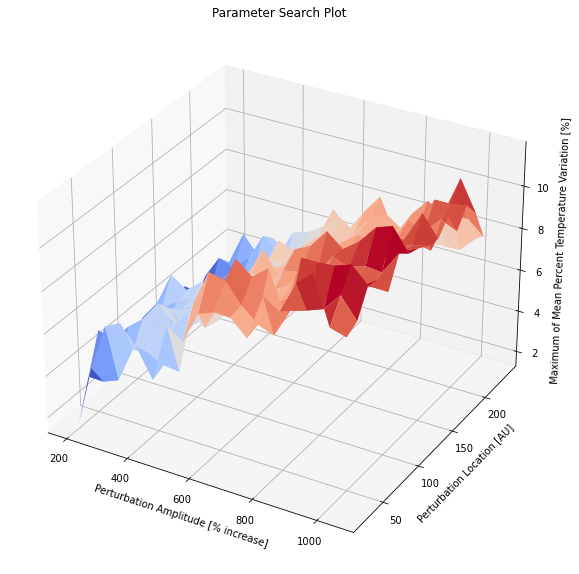

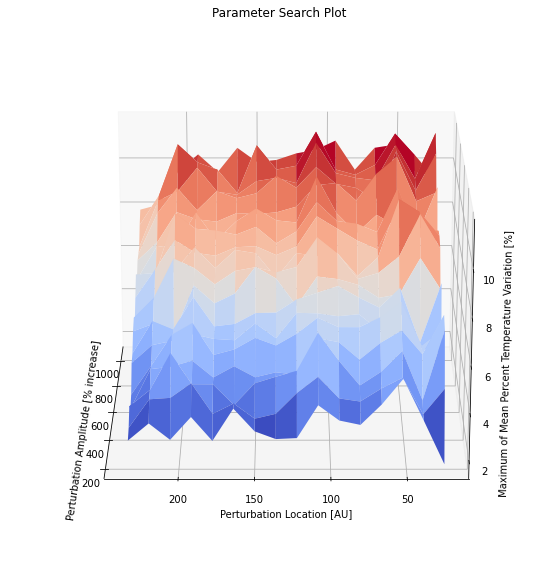

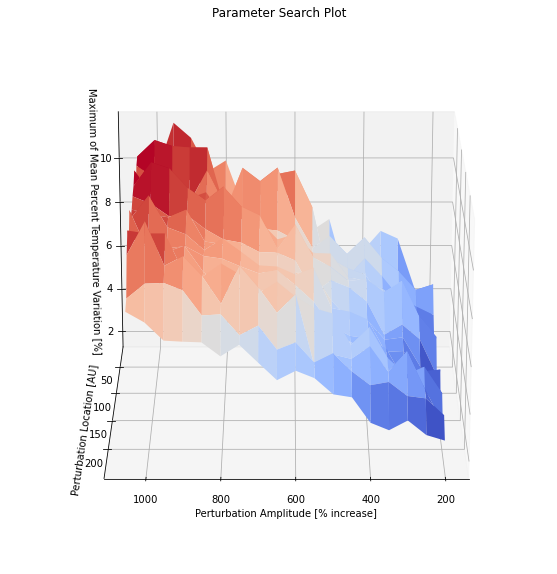

In [115]:
#Plot maximum temperature variation percentage as a function of radius and amplitude
fig = plt.figure(figsize = (10,10))
ax = plt.axes(projection='3d')
ax.set_title('Parameter Search Plot')
ax.set_xlabel('Perturbation Amplitude [% increase]')
ax.set_ylabel('Perturbation Location [AU]')
ax.set_zlabel('Maximum of Mean Percent Temperature Variation [%]')

X, Y = np.meshgrid(SD_amp, SD_loc)
Z = T_max
#Find a way to generalize the end bound of the plots before unphysical data due to boundary effects can ruin them.

ax.plot_surface(100*X[0:-2], Y[0:-2], Z[0:-2], rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
plt.show()

fig = plt.figure(figsize = (10,10))
ax = plt.axes(projection='3d')
ax.set_title('Parameter Search Plot')
ax.set_xlabel('Perturbation Amplitude [% increase]')
ax.set_ylabel('Perturbation Location [AU]')
ax.set_zlabel('Maximum of Mean Percent Temperature Variation [%]')

X, Y = np.meshgrid(SD_amp, SD_loc)
Z = T_max
ax.plot_surface(100*X[0:-2], Y[0:-2], Z[0:-2], rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
ax.view_init(20,180)
plt.show()

fig = plt.figure(figsize = (10,10))
ax = plt.axes(projection='3d')
ax.set_title('Parameter Search Plot')
ax.set_xlabel('Perturbation Amplitude [% increase]')
ax.set_ylabel('Perturbation Location [AU]')
ax.set_zlabel('Maximum of Mean Percent Temperature Variation [%]')
ax.plot_surface(100*X[0:-2], Y[0:-2], Z[0:-2], rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
ax.view_init(20,90)
plt.show()


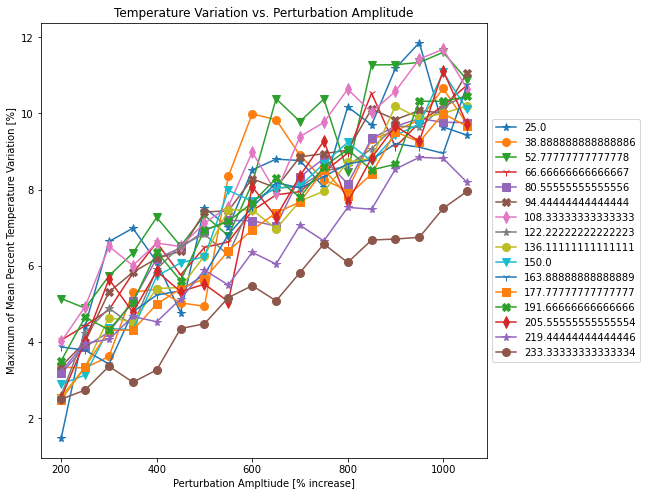

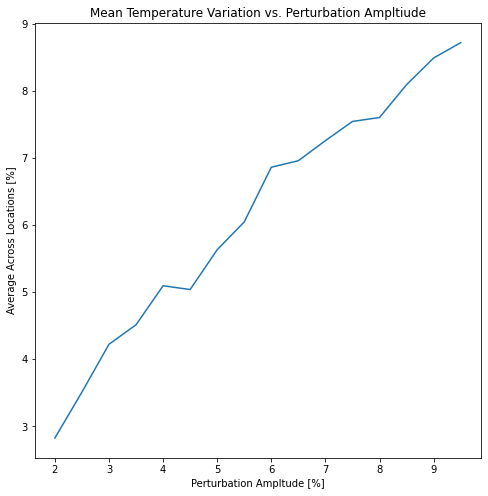

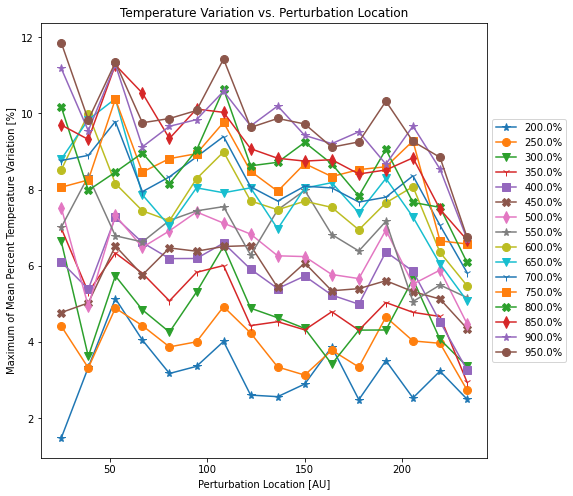

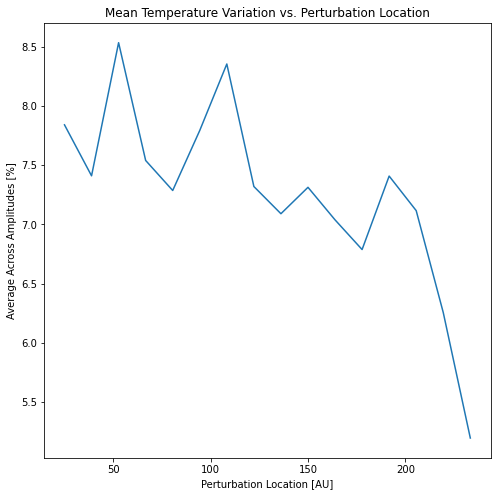

In [116]:
plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Ampltiude [% increase]')
plt.ylabel('Maximum of Mean Percent Temperature Variation [%]')
plt.title('Temperature Variation vs. Perturbation Amplitude')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']
for i in range(0, len(Z) - 2):
    plt.plot(100*X[i], Z[i], label = str(Y[i][0]), marker = markers[i % 7], markersize = 8)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

MeanMaxT = np.array([])
for i in range(0, len(np.transpose(Z)) - 2):
    MeanMaxT = np.append(MeanMaxT, sum(np.transpose(Z)[i]) / len(np.transpose(Z)[i])) 

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Ampltude [%]')
plt.ylabel('Average Across Locations [%]')
plt.title('Mean Temperature Variation vs. Perturbation Ampltiude')
plt.plot(SD_amp[0:-2], MeanMaxT)
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Maximum of Mean Percent Temperature Variation [%]')
plt.title('Temperature Variation vs. Perturbation Location')
for i in range(0, len(Z) - 2):
    plt.plot(np.transpose(Y[0:-2])[i], np.transpose(Z[0:-2])[i], label = str(100*X[0][i])+'%', marker = markers[i % 7], markersize = 8)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
plt.show()

MeanMaxT = np.array([])
for i in range(0, len(Z) - 2):
    MeanMaxT = np.append(MeanMaxT, sum(Z[i]) / len(Z[i])) 
    
plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Average Across Amplitudes [%]')
plt.title('Mean Temperature Variation vs. Perturbation Location')
plt.plot(SD_loc[0:-2], MeanMaxT)
plt.show()

#Inferences from the Plots:

#1. For any given perturbation location or any average across a collection of perturbation locations,
#an increase in perturbation amplitude yields a trend that resembles a linear increase in the maximum 
#of the mean percent temperature variation.

#2. For any given perturbation amplitude, an increase in perturbation location yields no noticeable trend in the
#maximum of the mean percent temperature variation.

#3. By averaging the maximums of the mean percent temperature variations over all perturbation 
#amplitudes at each location, plotting these averages as a function of perturbation location yields a parabolic
#trend with the peak somewhere between 87.5 and 118.75 AU.

#Say that you want to predict the maximum of the mean percent temperature variation, and you want to do so based 
#on knowledge of the surface density perturbation amplitude and the location of the perturbation. By fitting linear
#regressions to each location in the T variation vs. amplitude, we can find 


In [ ]:
#Surface Density Perturbation Gaussian Paramaters to Temperature Variation Gaussian Parameters

def SD_to_T(SD_amplitude, SD_location):
    T_gauss_param = [[[] for j in range(0, len(SD_amplitude))] for i in range(0, len(SD_location))]
    Param_map = [[[] for j in range(0, len(SD_amplitude))] for i in range(0, len(SD_location))]
    #Update the variables
    for i in range(0, len(SD_location)):
        for j in range(0, len(SD_amplitude)):
            T_gauss_param[i][j] = np.array([T_amp1[i][j], T_loc1[i][j], T_width1[i][j], T_amp2[i][j], T_loc2[i][j], T_width2[i][j]])
            Param_map[i][j] = [np.array([SD_location[i], SD_amplitude[j]]), T_gauss_param[i][j]]
    return Param_map

Param_map = SD_to_T(SD_amp, SD_loc)

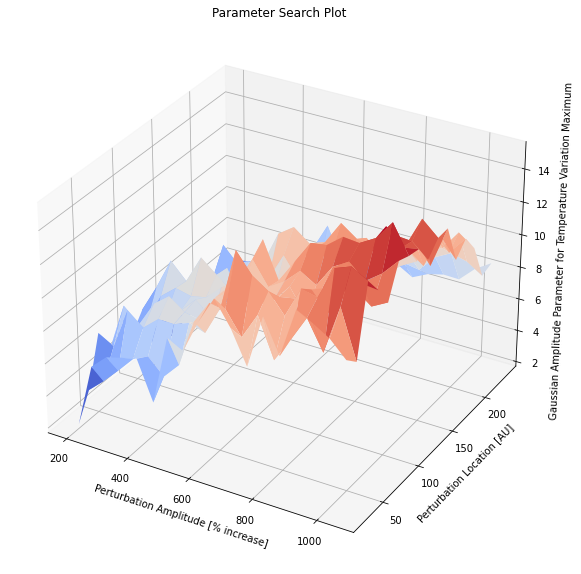

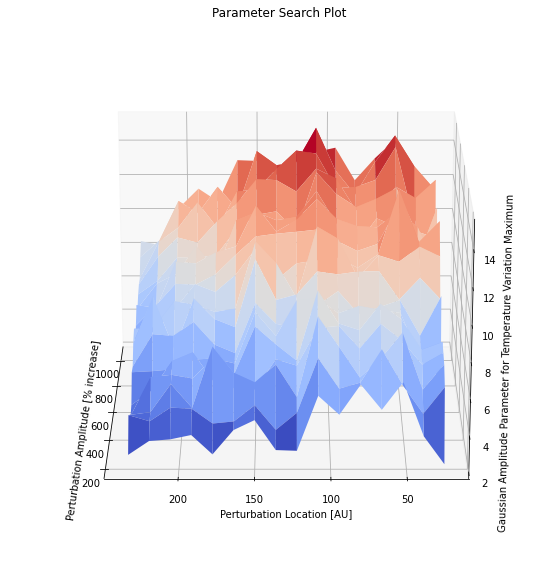

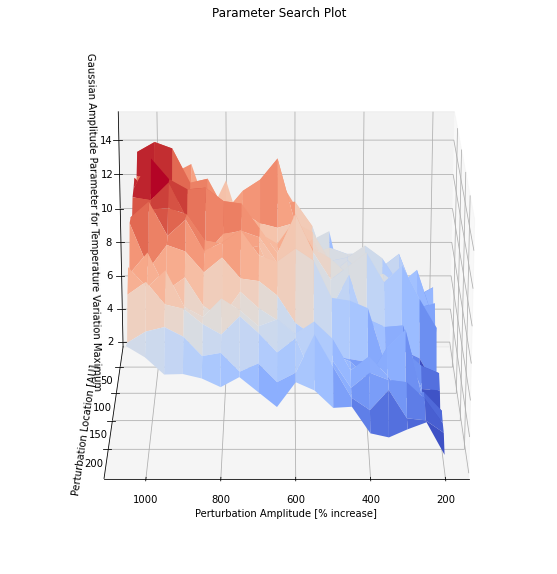

In [117]:
fig = plt.figure(figsize = (10,10))
ax = plt.axes(projection='3d')
ax.set_title('Parameter Search Plot')
ax.set_xlabel('Perturbation Amplitude [% increase]')
ax.set_ylabel('Perturbation Location [AU]')
ax.set_zlabel('Gaussian Amplitude Parameter for Temperature Variation Maximum')

X, Y = np.meshgrid(SD_amp, SD_loc)
Z = T_amp1
ax.plot_surface(100*X[0:-2], Y[0:-2], Z[0:-2], rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
plt.show()


fig = plt.figure(figsize = (10,10))
ax = plt.axes(projection='3d')
ax.set_title('Parameter Search Plot')
ax.set_xlabel('Perturbation Amplitude [% increase]')
ax.set_ylabel('Perturbation Location [AU]')
ax.set_zlabel('Gaussian Amplitude Parameter for Temperature Variation Maximum')

X, Y = np.meshgrid(SD_amp, SD_loc)
Z = T_amp1
ax.plot_surface(100*X[0:-2], Y[0:-2], Z[0:-2], rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
ax.view_init(20,180)
plt.show()

fig = plt.figure(figsize = (10,10))
ax = plt.axes(projection='3d')
ax.set_title('Parameter Search Plot')
ax.set_xlabel('Perturbation Amplitude [% increase]')
ax.set_ylabel('Perturbation Location [AU]')
ax.set_zlabel('Gaussian Amplitude Parameter for Temperature Variation Maximum')
ax.plot_surface(100*X[0:-2], Y[0:-2], Z[0:-2], rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
ax.view_init(20,90)
plt.show()

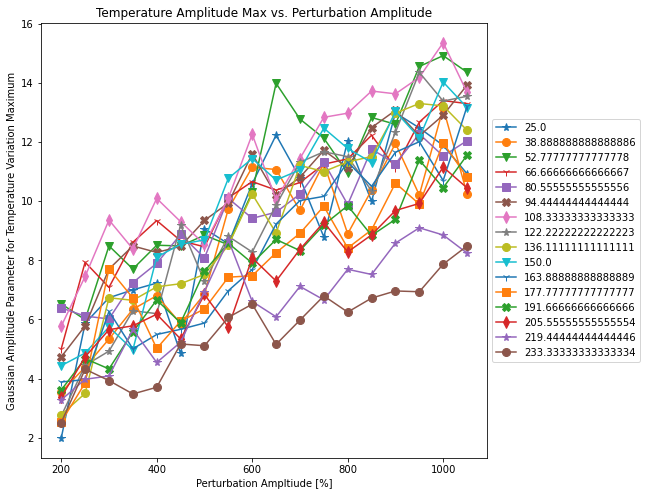

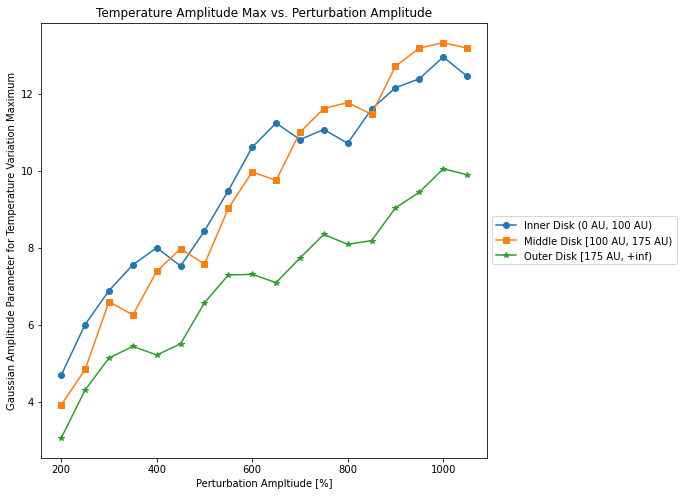

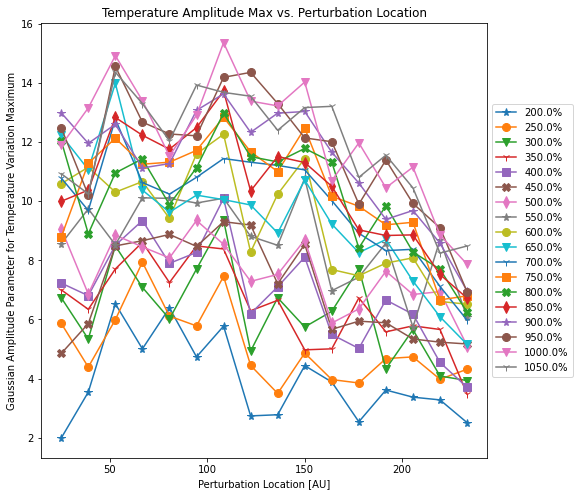

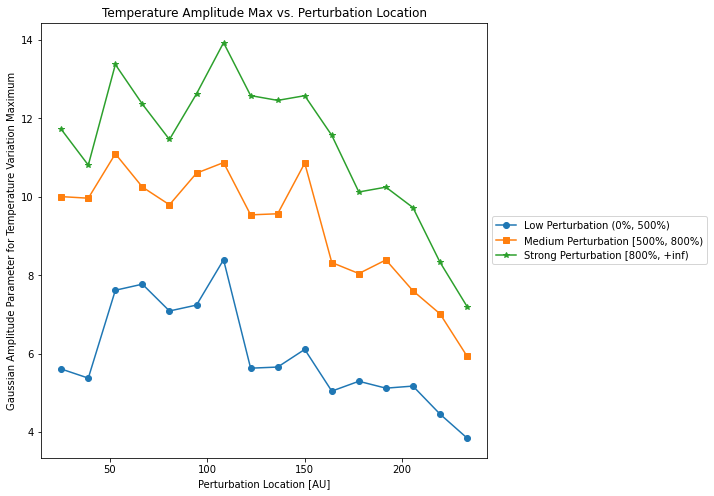

In [118]:
#Correspondance Between Surface Density Perturbation Amplitude and Temperature Variation Maximum Amplitude

#Inferences from Plots:

#Plots 1 and 2: The magnitude of the temperature variation maximum increases as the surface density perturbation
#amplitude increases. In the outer disk, the temperature variation maximum is less sensitive to surface density 
#perturbation, meaning a larger perturbation is needed to achieve the same value of temperature variation at an 
#inner radius.

#Plots 3 and 4:
#The magnitude of the temperature variation maximum spikes as the surface density perturbation location moves
#from the inner disk to the middle disk. It then tapers off as the perturbation location moves from the middle 
#disk to the outer disk. 

Z = T_amp1

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Ampltiude [%]')
plt.ylabel('Gaussian Amplitude Parameter for Temperature Variation Maximum')
plt.title('Temperature Amplitude Max vs. Perturbation Amplitude')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']
for i in range(0, len(Z) - 2):
    plt.plot(100*SD_amp, Z[i], label = str(Y[i][0]), marker = markers[i % 7], markersize = 8)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Ampltiude [%]')
plt.ylabel('Gaussian Amplitude Parameter for Temperature Variation Maximum')
plt.title('Temperature Amplitude Max vs. Perturbation Amplitude')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']

#find the index that corresponds to the first value over 100AU
Inner_Cutoff = 0
for i in SD_loc:
    if i < 100:
        Inner_Cutoff += 1
    else:
        break
        
Mid_Cutoff = 0
for i in SD_loc:
    if i < 175:
        Mid_Cutoff += 1
    else:
        break
        
plt.plot(100*SD_amp, sum(Z[0:Inner_Cutoff]) / len(Z[0:Inner_Cutoff]), label = 'Inner Disk (0 AU, 100 AU)', marker = markers[1])
plt.plot(100*SD_amp, sum(Z[Inner_Cutoff:Mid_Cutoff]) / len(Z[Inner_Cutoff:Mid_Cutoff]), label = 'Middle Disk [100 AU, 175 AU)', marker = markers[4])
plt.plot(100*SD_amp, sum(Z[Mid_Cutoff:-2]) / len(Z[Mid_Cutoff:-2]), label = 'Outer Disk [175 AU, +inf)', marker = markers[0])
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Gaussian Amplitude Parameter for Temperature Variation Maximum')
plt.title('Temperature Amplitude Max vs. Perturbation Location')
for i in range(0, len(Z)):
    plt.plot(SD_loc[0:-2], np.transpose(Z[0:-2])[i], label = str(100*X[0][i])+'%', marker = markers[i % 7], markersize = 8)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Gaussian Amplitude Parameter for Temperature Variation Maximum')
plt.title('Temperature Amplitude Max vs. Perturbation Location')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']
        
#Create amplitude categories
Low_Cutoff = 0
for i in SD_amp:
    if i < 5:
        Low_Cutoff += 1
    else:
        break

Mid_Cutoff = 0
for i in SD_amp:
    if i < 8:
        Mid_Cutoff += 1
    else:
        break

plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[0:Low_Cutoff]) / len(np.transpose(Z[0:-2])[0:Low_Cutoff]), label = 'Low Perturbation (0%, 500%)', marker = markers[1])
plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[Low_Cutoff:Mid_Cutoff]) / len(np.transpose(Z[0:-2])[Low_Cutoff:Mid_Cutoff]), label = 'Medium Perturbation [500%, 800%)', marker = markers[4])
plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[Mid_Cutoff:]) / len(np.transpose(Z[0:-2])[Mid_Cutoff:]), label = 'Strong Perturbation [800%, +inf)', marker = markers[0])
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


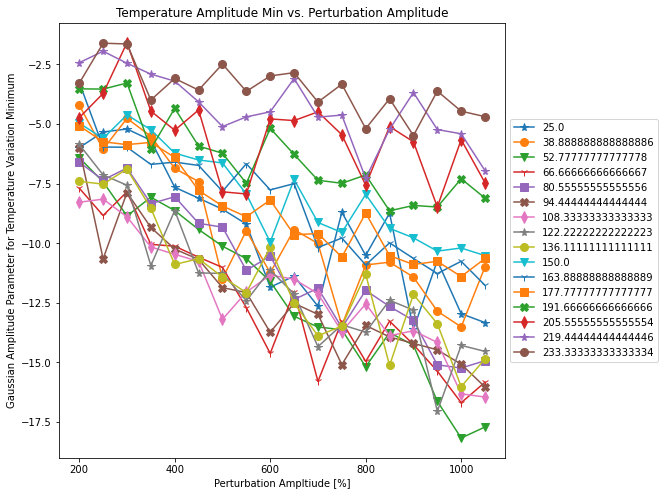

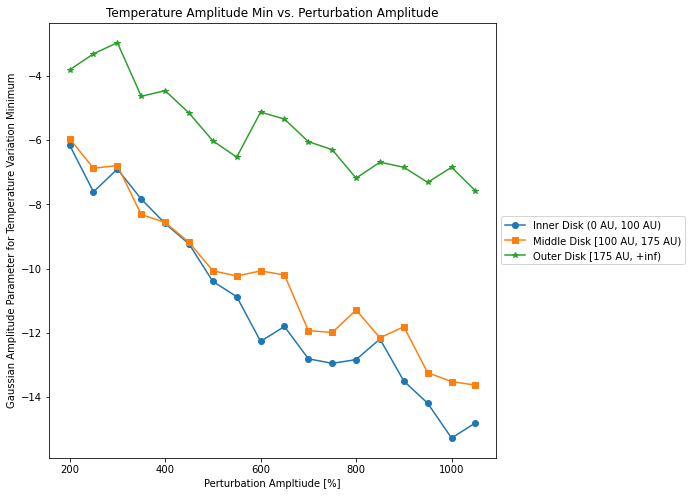

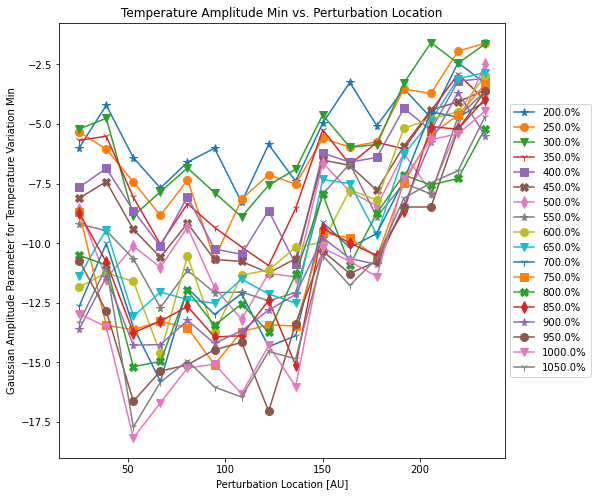

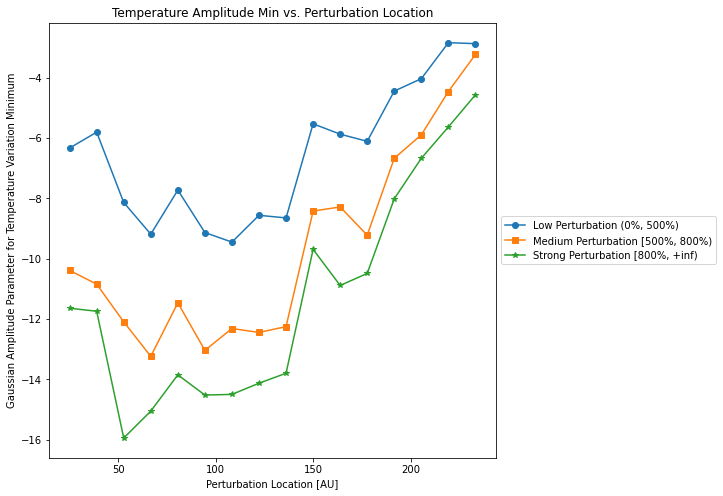

In [119]:
#Correspondance Between Surface Density Perturbation Amplitude and Temperature Variation Minimum Amplitude

#Inferences from Plots:

#Plots 1 and 2: The magnitude of the temperature variation minimum increases as the surface density perturbation
#amplitude increases. In the outer disk, the temperature variation minimum is less sensitive to surface density 
#perturbation, meaning a larger perturbation is needed to achieve the same value of temperature variation at an 
#inner radius.

#Plots 3 and 4:
#The magnitude of the temperature variation minimum spikes as the surface density perturbation location moves
#from the inner disk to the middle disk. It then tapers off as the perturbation location moves from the middle 
#disk to the outer disk. 

Z = T_amp2

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Ampltiude [%]')
plt.ylabel('Gaussian Amplitude Parameter for Temperature Variation Minimum')
plt.title('Temperature Amplitude Min vs. Perturbation Amplitude')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']
for i in range(0, len(Z) - 2):
    plt.plot(100*SD_amp, Z[i], label = str(Y[i][0]), marker = markers[i % 7], markersize = 8)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Ampltiude [%]')
plt.ylabel('Gaussian Amplitude Parameter for Temperature Variation Minimum')
plt.title('Temperature Amplitude Min vs. Perturbation Amplitude')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']
#find the index that corresponds to the first value over 100AU
Inner_Cutoff = 0
for i in SD_loc:
    if i < 100:
        Inner_Cutoff += 1
    else:
        break
        
Mid_Cutoff = 0
for i in SD_loc:
    if i < 175:
        Mid_Cutoff += 1
    else:
        break
        
plt.plot(100*SD_amp, sum(Z[0:Inner_Cutoff]) / len(Z[0:Inner_Cutoff]), label = 'Inner Disk (0 AU, 100 AU)', marker = markers[1])
plt.plot(100*SD_amp, sum(Z[Inner_Cutoff:Mid_Cutoff]) / len(Z[Inner_Cutoff:Mid_Cutoff]), label = 'Middle Disk [100 AU, 175 AU)', marker = markers[4])
plt.plot(100*SD_amp, sum(Z[Mid_Cutoff:-2]) / len(Z[Mid_Cutoff:-2]), label = 'Outer Disk [175 AU, +inf)', marker = markers[0])
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Gaussian Amplitude Parameter for Temperature Variation Min')
plt.title('Temperature Amplitude Min vs. Perturbation Location')
for i in range(0, len(Z)):
    plt.plot(SD_loc[0:-2], np.transpose(Z[0:-2])[i], label = str(100*X[0][i])+'%', marker = markers[i % 7], markersize = 8)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Gaussian Amplitude Parameter for Temperature Variation Minimum')
plt.title('Temperature Amplitude Min vs. Perturbation Location')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']

#Create amplitude categories
Low_Cutoff = 0
for i in SD_amp:
    if i < 5:
        Low_Cutoff += 1
    else:
        break

Mid_Cutoff = 0
for i in SD_amp:
    if i < 8:
        Mid_Cutoff += 1
    else:
        break

plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[0:Low_Cutoff]) / len(np.transpose(Z[0:-2])[0:Low_Cutoff]), label = 'Low Perturbation (0%, 500%)', marker = markers[1])
plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[Low_Cutoff:Mid_Cutoff]) / len(np.transpose(Z[0:-2])[Low_Cutoff:Mid_Cutoff]), label = 'Medium Perturbation [500%, 800%)', marker = markers[4])
plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[Mid_Cutoff:]) / len(np.transpose(Z[0:-2])[Mid_Cutoff:]), label = 'Strong Perturbation [800%, +inf)', marker = markers[0])
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


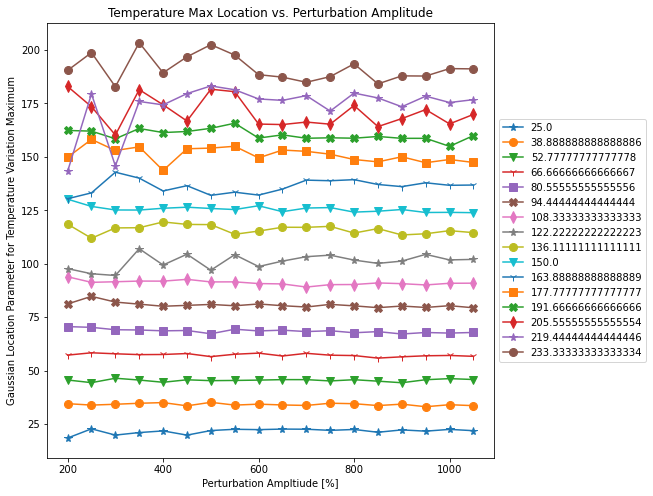

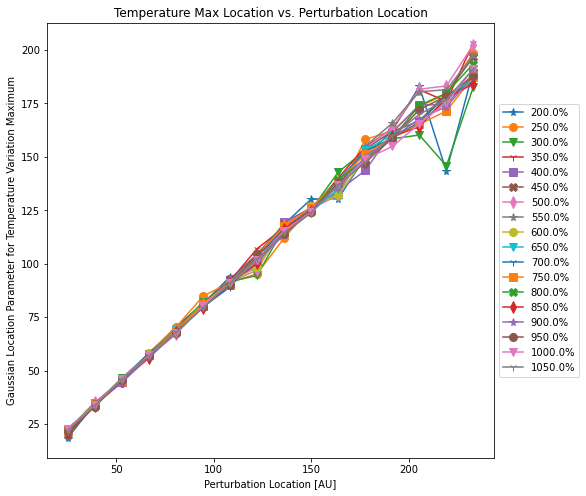

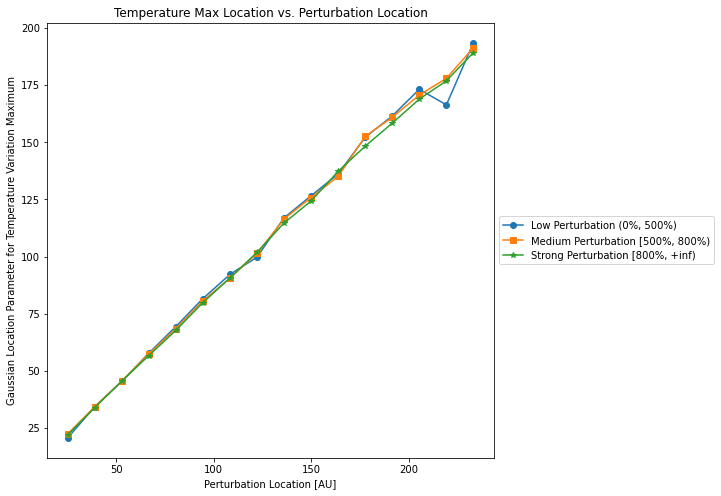

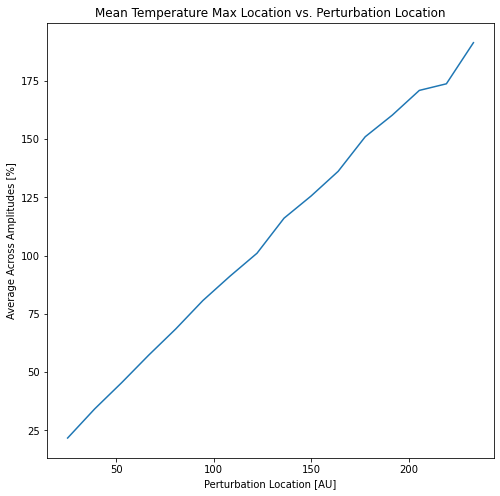

In [120]:
#Correspondance Between Surface Density Perturbation Location and Temperature Variation Maximum Location

#Inferences from Plots:

#Plot 1: For a given surface density perturbation location, changing the amplitude has little to no effect on the 
#location of the temperature variation maximum.

#Plots 2 - 4: For all surface density perturbation amplitudes, there is a positive linear relationship between 
#the surface density perturbation location and the location of the temperature variation maximum.

Z = T_loc1

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Ampltiude [%]')
plt.ylabel('Gaussian Location Parameter for Temperature Variation Maximum')
plt.title('Temperature Max Location vs. Perturbation Amplitude')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']
for i in range(0, len(Z) - 2):
    plt.plot(100*SD_amp, Z[i], label = str(Y[i][0]), marker = markers[i % 7], markersize = 8)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Gaussian Location Parameter for Temperature Variation Maximum')
plt.title('Temperature Max Location vs. Perturbation Location')
for i in range(0, len(Z)):
    plt.plot(SD_loc[0:-2], np.transpose(Z[0:-2])[i], label = str(100*X[0][i])+'%', marker = markers[i % 7], markersize = 8)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Gaussian Location Parameter for Temperature Variation Maximum')
plt.title('Temperature Max Location vs. Perturbation Location')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']

#Create amplitude categories
Low_Cutoff = 0
for i in SD_amp:
    if i < 5:
        Low_Cutoff += 1
    else:
        break

Mid_Cutoff = 0
for i in SD_amp:
    if i < 8:
        Mid_Cutoff += 1
    else:
        break

plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[0:Low_Cutoff]) / len(np.transpose(Z[0:-2])[0:Low_Cutoff]), label = 'Low Perturbation (0%, 500%)', marker = markers[1])
plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[Low_Cutoff:Mid_Cutoff]) / len(np.transpose(Z[0:-2])[Low_Cutoff:Mid_Cutoff]), label = 'Medium Perturbation [500%, 800%)', marker = markers[4])
plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[Mid_Cutoff:]) / len(np.transpose(Z[0:-2])[Mid_Cutoff:]), label = 'Strong Perturbation [800%, +inf)', marker = markers[0])
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

MeanMaxLoc = np.array([])
for i in range(0, len(Z) - 2):
    MeanMaxLoc = np.append(MeanMaxLoc, sum(Z[i]) / len(Z[i])) 
    
plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Average Across Amplitudes [%]')
plt.title('Mean Temperature Max Location vs. Perturbation Location')
plt.plot(SD_loc[0:-2], MeanMaxLoc)
plt.show()

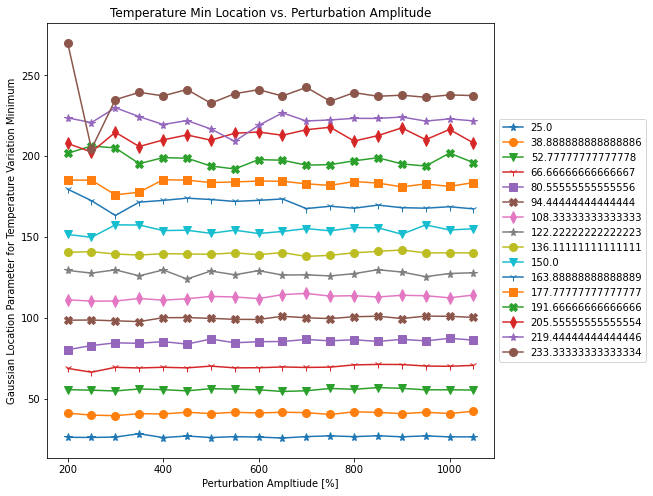

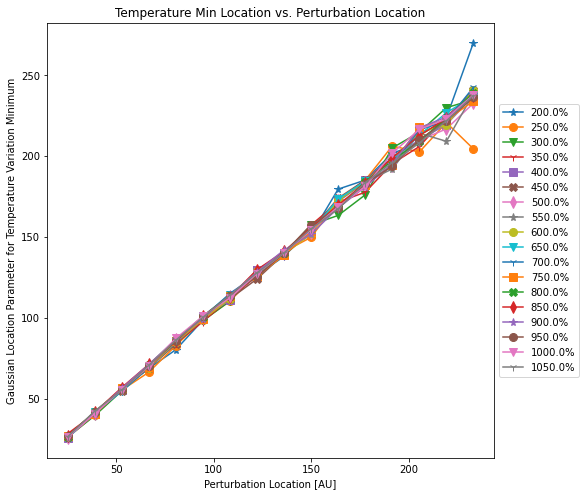

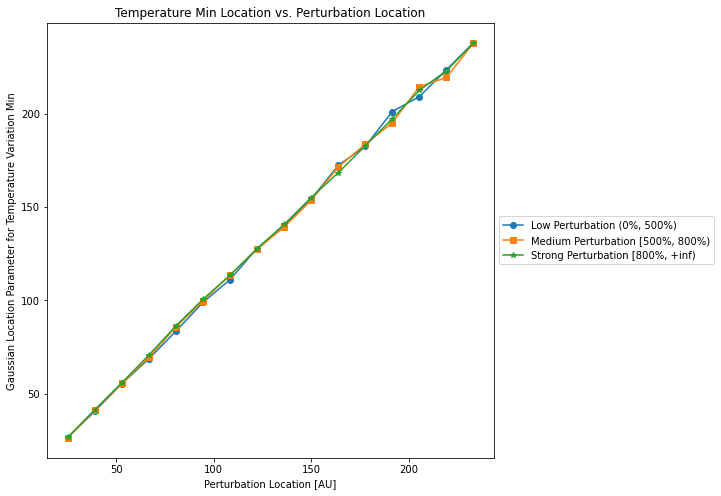

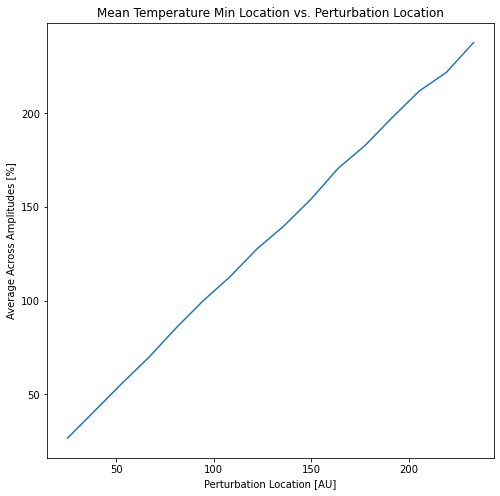

In [123]:
#Correspondance Between Surface Density Perturbation Location and Temperature Variation Minimum Location

#Inferences from Plots:

#Plot 1: For a given surface density perturbation location, changing the amplitude has little to no effect on the 
#location of the temperature variation minimum.

#Plots 2 - 4: For all surface density perturbation amplitudes, there is a positive linear relationship between 
#the surface density perturbation location and the location of the temperature variation minimum.


Z = T_loc2

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Ampltiude [%]')
plt.ylabel('Gaussian Location Parameter for Temperature Variation Minimum')
plt.title('Temperature Min Location vs. Perturbation Amplitude')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']
for i in range(0, len(Z) - 2):
    plt.plot(100*SD_amp, Z[i], label = str(Y[i][0]), marker = markers[i % 7], markersize = 8)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Gaussian Location Parameter for Temperature Variation Minimum')
plt.title('Temperature Min Location vs. Perturbation Location')
for i in range(0, len(Z)):
    plt.plot(SD_loc[0:-2], np.transpose(Z[0:-2])[i], label = str(100*X[0][i])+'%', marker = markers[i % 7], markersize = 8)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Gaussian Location Parameter for Temperature Variation Min')
plt.title('Temperature Min Location vs. Perturbation Location')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']

#Create amplitude categories
Low_Cutoff = 0
for i in SD_amp:
    if i < 5:
        Low_Cutoff += 1
    else:
        break

Mid_Cutoff = 0
for i in SD_amp:
    if i < 8:
        Mid_Cutoff += 1
    else:
        break

plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[0:Low_Cutoff]) / len(np.transpose(Z[0:-2])[0:Low_Cutoff]), label = 'Low Perturbation (0%, 500%)', marker = markers[1])
plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[Low_Cutoff:Mid_Cutoff]) / len(np.transpose(Z[0:-2])[Low_Cutoff:Mid_Cutoff]), label = 'Medium Perturbation [500%, 800%)', marker = markers[4])
plt.plot(SD_loc[0:-2], sum(np.transpose(Z[0:-2])[Mid_Cutoff:]) / len(np.transpose(Z[0:-2])[Mid_Cutoff:]), label = 'Strong Perturbation [800%, +inf)', marker = markers[0])
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


MeanMinLoc = np.array([])
for i in range(0, len(Z) - 2):
    MeanMinLoc = np.append(MeanMinLoc, sum(Z[i]) / len(Z[i])) 
    
plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Average Across Amplitudes [%]')
plt.title('Mean Temperature Min Location vs. Perturbation Location')
plt.plot(SD_loc[0:-2], MeanMinLoc)
plt.show()

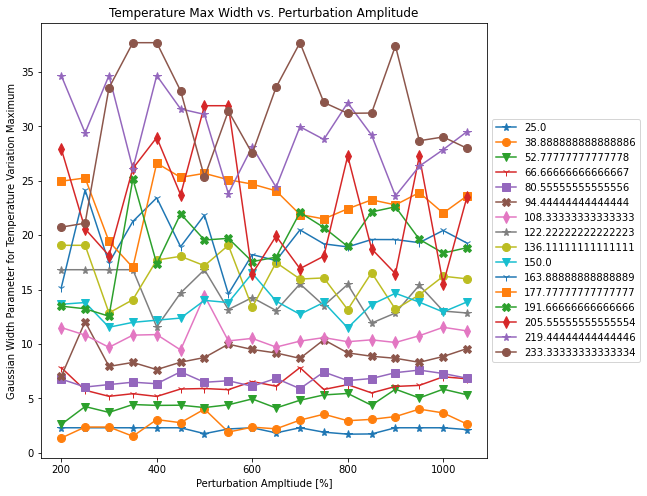

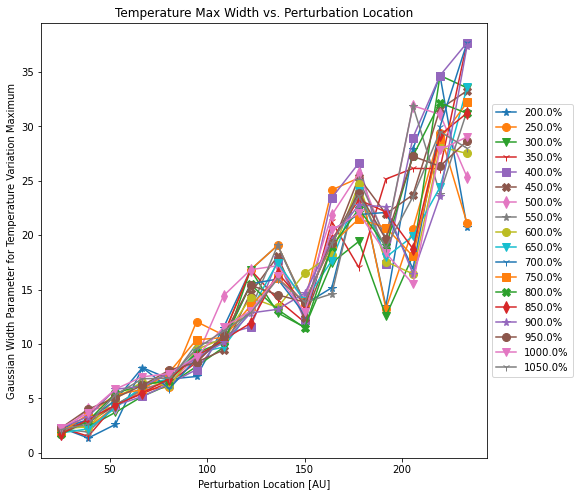

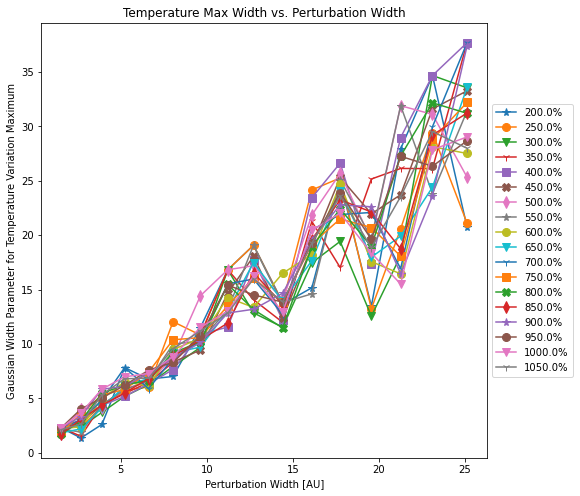

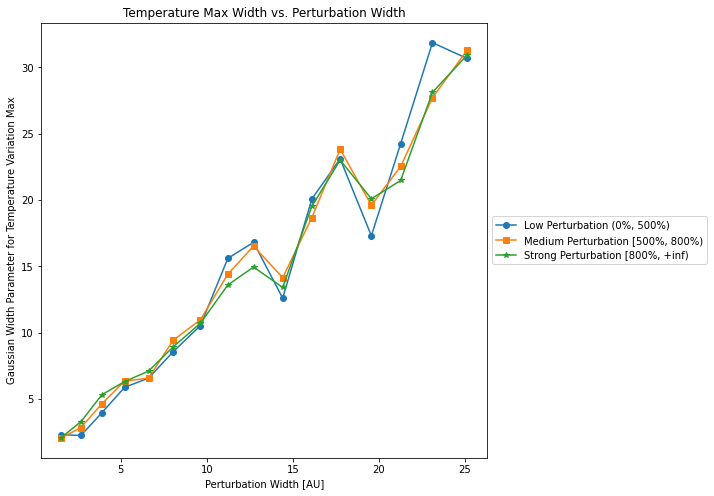

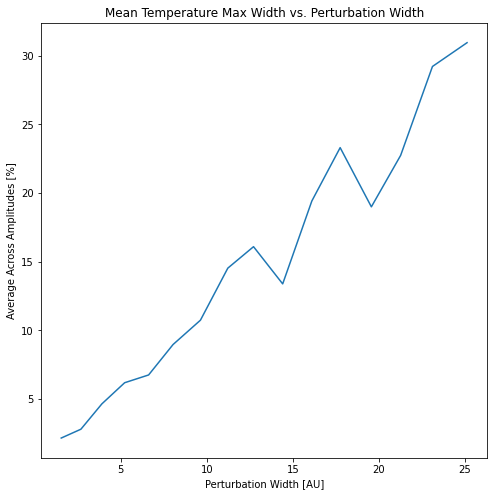

In [132]:
#Correspondance Between Surface Density Perturbation Width and Temperature Variation Maximum Width

#Plot Inferences:

#1. For all perturbation strengths, as the surface density perturbation width increases, the width of the gaussian 
#that primarily models the temperature variation maximum increases at about the same rate, which approximately 
#results in a positive linear relationship.

Z = T_width1

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Ampltiude [%]')
plt.ylabel('Gaussian Width Parameter for Temperature Variation Maximum')
plt.title('Temperature Max Width vs. Perturbation Amplitude')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']
for i in range(0, len(Z) - 2):
    plt.plot(100*SD_amp, Z[i], label = str(Y[i][0]), marker = markers[i % 7], markersize = 8)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Gaussian Width Parameter for Temperature Variation Maximum')
plt.title('Temperature Max Width vs. Perturbation Location')
for i in range(0, len(Z)):
    plt.plot(SD_loc[0:-2], np.transpose(Z[0:-2])[i], label = str(100*X[0][i])+'%', marker = markers[i % 7], markersize = 8)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Width [AU]')
plt.ylabel('Gaussian Width Parameter for Temperature Variation Maximum')
plt.title('Temperature Max Width vs. Perturbation Width')
for i in range(0, len(Z)):
    plt.plot(SD_width[0:-2], np.transpose(Z[0:-2])[i], label = str(100*X[0][i])+'%', marker = markers[i % 7], markersize = 8)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Width [AU]')
plt.ylabel('Gaussian Width Parameter for Temperature Variation Max')
plt.title('Temperature Max Width vs. Perturbation Width')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']

#Create amplitude categories
Low_Cutoff = 0
for i in SD_amp:
    if i < 5:
        Low_Cutoff += 1
    else:
        break

Mid_Cutoff = 0
for i in SD_amp:
    if i < 8:
        Mid_Cutoff += 1
    else:
        break

plt.plot(SD_width[0:-2], sum(np.transpose(Z[0:-2])[0:Low_Cutoff]) / len(np.transpose(Z[0:-2])[0:Low_Cutoff]), label = 'Low Perturbation (0%, 500%)', marker = markers[1])
plt.plot(SD_width[0:-2], sum(np.transpose(Z[0:-2])[Low_Cutoff:Mid_Cutoff]) / len(np.transpose(Z[0:-2])[Low_Cutoff:Mid_Cutoff]), label = 'Medium Perturbation [500%, 800%)', marker = markers[4])
plt.plot(SD_width[0:-2], sum(np.transpose(Z[0:-2])[Mid_Cutoff:]) / len(np.transpose(Z[0:-2])[Mid_Cutoff:]), label = 'Strong Perturbation [800%, +inf)', marker = markers[0])
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


MeanMaxWidth = np.array([])
for i in range(0, len(Z) - 2):
    MeanMaxWidth = np.append(MeanMaxWidth, sum(Z[i]) / len(Z[i])) 
    
plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Width [AU]')
plt.ylabel('Average Across Amplitudes [%]')
plt.title('Mean Temperature Max Width vs. Perturbation Width')
plt.plot(SD_width[0:-2], MeanMaxWidth)
plt.show()

In [ ]:
#Correspondance Between Surface Density Perturbation Width and Temperature Variation Minimum Width
#Plot Inferences:

#1. For all perturbation strengths, as the surface density perturbation width increases, the width of the gaussian 
#that primarily models the temperature variation maximum increases at about the same rate, which approximately 
#results in a positive linear relationship.

Z = T_width2

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Ampltiude [%]')
plt.ylabel('Gaussian Width Parameter for Temperature Variation Minimum')
plt.title('Temperature Min Width vs. Perturbation Amplitude')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']
for i in range(0, len(Z) - 1):
    plt.plot(100*SD_amp, Z[i], label = str(Y[i][0]), marker = markers[i % 7], markersize = 8)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Gaussian Width Parameter for Temperature Variation Minimum')
plt.title('Temperature Min Width vs. Perturbation Location')
for i in range(0, len(Z)):
    plt.plot(SD_loc[0:-1], np.transpose(Z[0:-1])[i], label = str(100*X[0][i])+'%', marker = markers[i % 7], markersize = 8)
    # except:
    #     plt.plot(np.transpose(Y[0:-1])[i], np.transpose(Z[0:-1])[i], label = str(100*X[0][i])+'%', marker = i + 2, markersize = 10)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Gaussian Width Parameter for Temperature Variation Min')
plt.title('Temperature Min Width vs. Perturbation Location')
markers = ['*', 'o', 'v', '1', 's', 'X', 'd']

#Create amplitude categories
Low_Cutoff = 0
for i in SD_amp:
    if i < 5:
        Low_Cutoff += 1
    else:
        break

Mid_Cutoff = 0
for i in SD_amp:
    if i < 8:
        Mid_Cutoff += 1
    else:
        break

plt.plot(SD_loc[0:-1], sum(np.transpose(Z[0:-1])[0:Low_Cutoff]) / len(np.transpose(Z[0:-1])[0:Low_Cutoff]), label = 'Low Perturbation (0%, 500%)', marker = markers[1])
plt.plot(SD_loc[0:-1], sum(np.transpose(Z[0:-1])[Low_Cutoff:Mid_Cutoff]) / len(np.transpose(Z[0:-1])[Low_Cutoff:Mid_Cutoff]), label = 'Medium Perturbation [500%, 800%)', marker = markers[4])
plt.plot(SD_loc[0:-1], sum(np.transpose(Z[0:-1])[Mid_Cutoff:-1]) / len(np.transpose(Z[0:-1])[Mid_Cutoff:-1]), label = 'Strong Perturbation [800%, +inf)', marker = markers[0])
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

MeanMinWidth = np.array([])
for i in range(0, len(Z) - 1):
    MeanMinWidth = np.append(MeanMinWidth, sum(Z[i]) / len(Z[i])) 
    
plt.figure(figsize = (8,8))
plt.xlabel('Perturbation Location [AU]')
plt.ylabel('Average Across Amplitudes [%]')
plt.title('Mean Temperature Min Width vs. Perturbation Location')
plt.plot(SD_loc[0:-1], MeanMinWidth)
plt.show()

In [ ]:
#
# Make sure to have done the following beforhand:
#
#  First compile RADMC-3D
#  Then run:
#   python problem_setup.py
#   radmc3d mctherm
#

dpc = 140.     # Distance in parsec (for conversion to Jy/pixel in 1.3 mm map)

#
# Make and plot image of full disk at 1.3 mm: thermal dust emission
#
makeImage(npix=200,incl=60.,phi=30.,wav=1.0e3,sizeau=200)   # This calls radmc3d 
im_mmPrePert1 = readImage()
plt.figure()
plotImage(im_mmPrePert1,au=True,log=True,maxlog=3,bunit='jy/pixel',dpc=dpc,cmap='magma')
plt.show()

    
#
# Make and plot image of full disk at 1 microns: scattered light
#
makeImage(npix=200,incl=60.,phi=30.,wav=10,sizeau=200)   # This calls radmc3d 
im_1PrePert2 = readImage()
plt.figure()
plotImage(im_1PrePert2,au=True,log=True,vmax=-10,vmin=-15,bunit='inu',cmap='hot')
plt.show()